In [1]:
!git clone -b module7 https://github.com/toan-ly/AIVN-AIO2024.git

Cloning into 'AIVN-AIO2024'...
remote: Enumerating objects: 366, done.
remote: Counting objects: 100% (122/122), done.
remote: Compressing objects: 100% (107/107), done.
remote: Total 366 (delta 26), reused 73 (delta 13), pack-reused 244 (from 1)
Receiving objects: 100% (366/366), 30.74 MiB | 11.01 MiB/s, done.
Resolving deltas: 100% (89/89), done.
Updating files: 100% (135/135), done.


In [2]:
import sys
sys.path.append('/content/AIVN-AIO2024/module7/week1-domain-conversion')

In [ ]:
# Khoa_LHR_image.zip
!gdown --id 1bsWkNmmYvBrgE1c58SGJFcCjQv3SUyH3
!unzip /content/Khoa_LHR_image.zip

In [4]:
!pip install torcheval

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 4.8 MB/s eta 0:00:00


In [5]:
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
from torch import optim
from PIL import Image
from torchvision import transforms
import os
import matplotlib.pyplot as plt
import numpy as np
from torcheval.metrics.functional import peak_signal_noise_ratio
import time

from unet_sr import UNet

In [6]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
torch.manual_seed(66)

In [7]:
LHR_TRAIN_DATA_PATH = '/content/Khoa_LHR_image/train'
LHR_VAL_DATA_PATH = '/content/Khoa_LHR_image/val'
BATCH_SIZE = 8
LOW_IMG_HEIGHT = 64
LOW_IMG_WIDTH = 64

#### No skip connection UNet

In [8]:
unet_model = UNet(use_skip=False).to(device)
img = torch.ones(2, 3, 64, 64).to(device)
unet_model(img).shape

torch.Size([2, 3, 256, 256])

#### Skip connection UNet

In [10]:
unet_model = UNet().to(device)
img = torch.ones(2, 3, 64, 64).to(device)
unet_model(img).shape

torch.Size([2, 3, 256, 256])

### Prepare Super Resolution Dataset

#### Split data

In [11]:
class ImageDataset(Dataset):
    def __init__(self, img_dir, is_train=True):
        self.resize = transforms.Resize((LOW_IMG_WIDTH, LOW_IMG_HEIGHT),
                                        antialias=True)
        self.is_train = is_train
        self.img_dir = img_dir
        self.images = os.listdir(img_dir)

    def __len__(self):
        return len(self.images)

    def normalize(self, input_image, target_image):
        input_image  = input_image * 2 - 1
        target_image = target_image * 2 - 1

        return input_image, target_image

    def random_jitter(self, input_image, target_image):
        if torch.rand([]) < 0.5:
            input_image = transforms.functional.hflip(input_image)
            target_image = transforms.functional.hflip(target_image)

        return input_image, target_image

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.images[idx])
        image = np.array(Image.open(img_path).convert("RGB"))
        image = transforms.functional.to_tensor(image)

        input_image = self.resize(image).type(torch.float32)
        target_image = image.type(torch.float32)

        input_image, target_image = self.normalize(input_image, target_image)

        if self.is_train:
            input_image, target_image = self.random_jitter(input_image, target_image)

        return input_image, target_image

In [12]:
train_dataset = ImageDataset(LHR_TRAIN_DATA_PATH, is_train=True)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = ImageDataset(LHR_VAL_DATA_PATH, is_train=False)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

Text(0.5, 1.0, 'Target')

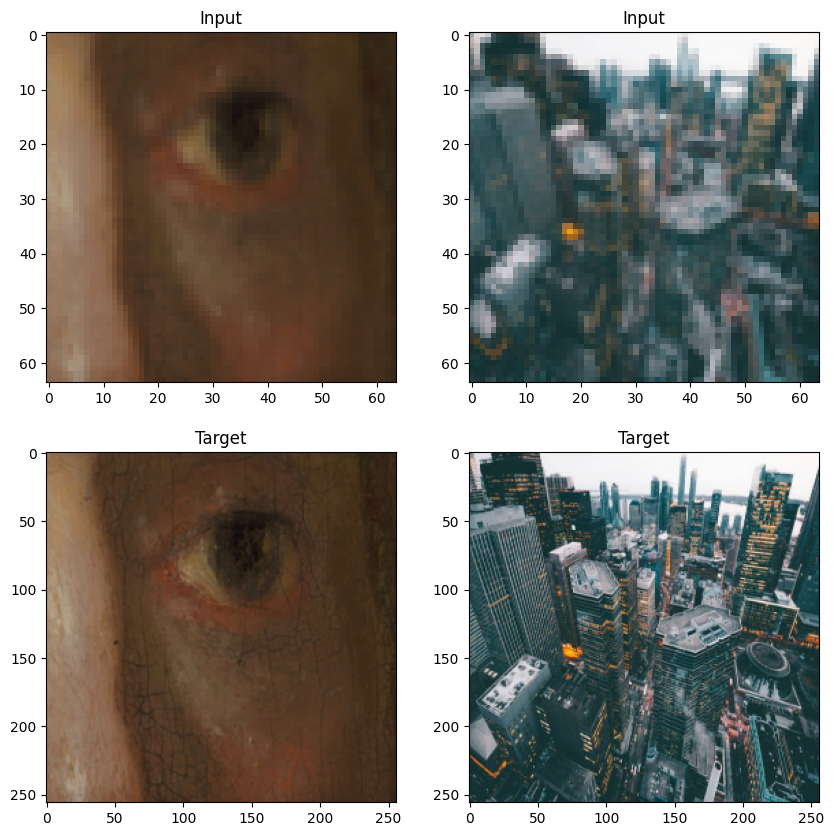

In [13]:
in_batch, tar_batch = next(iter(train_loader))
in_batch = (in_batch + 1) / 2
tar_batch = (tar_batch + 1) / 2

plt.figure(figsize=(10, 10))

ax = plt.subplot(2, 2, 1)
plt.imshow(np.squeeze(in_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Input")

ax = plt.subplot(2, 2, 3)
plt.imshow(np.squeeze(tar_batch[0].numpy().transpose((1, 2, 0))))
plt.title("Target")

ax = plt.subplot(2, 2, 2)
plt.imshow(np.squeeze(in_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Input")

ax = plt.subplot(2, 2, 4)
plt.imshow(np.squeeze(tar_batch[1].numpy().transpose((1, 2, 0))))
plt.title("Target")

### Train

In [14]:
def generate_images(model, inputs, labels):
    model.eval()
    with torch.no_grad():
        inputs, labels = inputs.to(device), labels.to(device)
        predictions = model(inputs)
    inputs, labels, predictions = inputs.cpu().numpy(), labels.cpu().numpy(), predictions.cpu().numpy()

    plt.figure(figsize=(15,20))

    display_list = [inputs[-1].transpose((1, 2, 0)), labels[-1].transpose((1, 2, 0)), predictions[-1].transpose((1, 2, 0))]
    title = ['Input', 'Real', 'Predicted']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow((display_list[i] + 1) / 2)
        plt.axis('off')
    plt.show()

In [15]:
def train_epoch(model, optimizer, criterion, train_dataloader, device, epoch=0, log_interval=50):
    model.train()
    total_psnr, total_count = 0, 0
    losses = []
    start_time = time.time()

    for idx, (inputs, labels) in enumerate(train_dataloader):
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        # Forward pass
        predictions = model(inputs)

        # Compute loss
        loss = criterion(predictions, labels)
        losses.append(loss.item())

        # Backward pass
        loss.backward()
        optimizer.step()

        # Compute PSNR for the batch
        batch_psnr = peak_signal_noise_ratio(predictions, labels)
        total_psnr += batch_psnr
        total_count += 1

        # Logging
        if idx % log_interval == 0 and idx > 0:
            elapsed = time.time() - start_time
            avg_psnr = total_psnr / total_count
            print(
                f"| epoch {epoch:3d} | {idx:5d}/{len(train_dataloader):5d} batches "
                f"| avg_psnr {avg_psnr:8.3f} | elapsed time {elapsed:5.2f}s"
            )
            start_time = time.time()

    # Compute epoch metrics
    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)

    return epoch_psnr, epoch_loss


In [16]:
def evaluate_epoch(model, criterion, valid_dataloader, device):
    model.eval()
    total_psnr, total_count = 0, 0
    losses = []

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(valid_dataloader):
            inputs = inputs.to(device)
            labels = labels.to(device)

            predictions = model(inputs)

            loss = criterion(predictions, labels)
            losses.append(loss.item())

            total_psnr +=  peak_signal_noise_ratio(predictions, labels)
            total_count += 1

    epoch_psnr = total_psnr / total_count
    epoch_loss = sum(losses) / len(losses)
    return epoch_psnr, epoch_loss

In [17]:
def train(model, model_name, save_model, optimizer, criterion, train_dataloader, valid_dataloader, num_epochs, device):
    train_psnrs, train_losses = [], []
    eval_psnrs, eval_losses = [], []
    best_psnr_eval = -1000
    times = []
    for epoch in range(1, num_epochs+1):
        epoch_start_time = time.time()

        # Training
        train_psnr, train_loss = train_epoch(model, optimizer, criterion, train_dataloader, device, epoch)
        train_psnrs.append(train_psnr.cpu())
        train_losses.append(train_loss)

        # Evaluation
        eval_psnr, eval_loss = evaluate_epoch(model, criterion, valid_dataloader, device)
        eval_psnrs.append(eval_psnr.cpu())
        eval_losses.append(eval_loss)

        # Save best model
        if best_psnr_eval < eval_psnr :
            torch.save(model.state_dict(), save_model + f'/{model_name}.pt')
            inputs_t, targets_t = next(iter(valid_dataloader))
            generate_images(model, inputs_t, targets_t)
            best_psnr_eval = eval_psnr
        times.append(time.time() - epoch_start_time)

        # Print loss, psnr end epoch
        print("-" * 59)
        print(
            "| End of epoch {:3d} | Time: {:5.2f}s | Train psnr {:8.3f} | Train Loss {:8.3f} "
            "| Valid psnr {:8.3f} | Valid Loss {:8.3f} ".format(
                epoch, time.time() - epoch_start_time, train_psnr, train_loss, eval_psnr, eval_loss
            )
        )
        print("-" * 59)

    # Load best model
    model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))
    model.eval()
    metrics = {
        'train_psnr': train_psnrs,
        'train_loss': train_losses,
        'valid_psnr': eval_psnrs,
        'valid_loss': eval_losses,
        'time': times
    }
    return model, metrics

In [18]:
def plot_result(num_epochs, train_psnrs, eval_psnrs, train_losses, eval_losses):
    epochs = list(range(num_epochs))
    fig, axs = plt.subplots(nrows = 1, ncols =2 , figsize = (12, 6))
    axs[0].plot(epochs, train_psnrs, label = "Training")
    axs[0].plot(epochs, eval_psnrs, label = "Evaluation")
    axs[1].plot(epochs, train_losses, label = "Training")
    axs[1].plot(epochs, eval_losses, label = "Evaluation")
    axs[0].set_xlabel("Epochs")
    axs[1].set_xlabel("Epochs")
    axs[0].set_ylabel("PSNR")
    axs[1].set_ylabel("Loss")
    plt.legend()

In [19]:
def predict_and_display(model, test_dataloader, device):
    model.eval()

    with torch.no_grad():
        for idx, (inputs, labels) in enumerate(test_dataloader):
            if idx >= 10:
                break
            inputs = inputs.to(device)
            predictions = model(inputs)
            generate_images(model, inputs, labels)
            plt.show()

#### Unet No Skip Connection


| epoch   1 |    50/   86 batches | avg_psnr   14.540 | elapsed time 20.98s


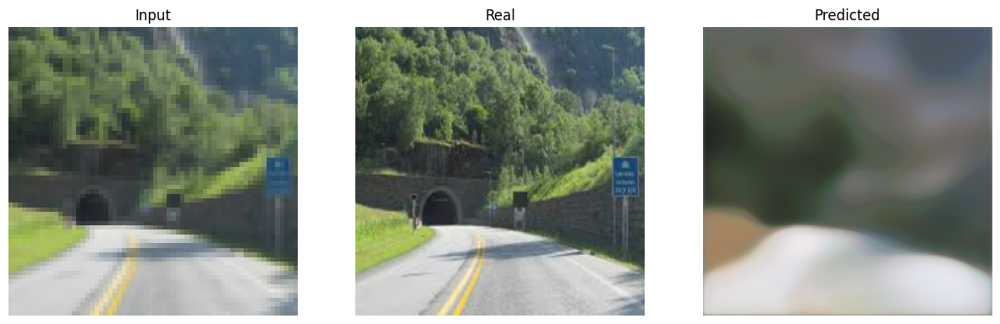

-----------------------------------------------------------
| End of epoch   1 | Time: 38.72s | Train psnr   15.257 | Train Loss    0.266 | Valid psnr   16.650 | Valid Loss    0.203 
-----------------------------------------------------------
| epoch   2 |    50/   86 batches | avg_psnr   16.487 | elapsed time 20.17s
-----------------------------------------------------------
| End of epoch   2 | Time: 37.32s | Train psnr   16.417 | Train Loss    0.215 | Valid psnr   12.034 | Valid Loss    0.333 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | avg_psnr   16.506 | elapsed time 20.64s


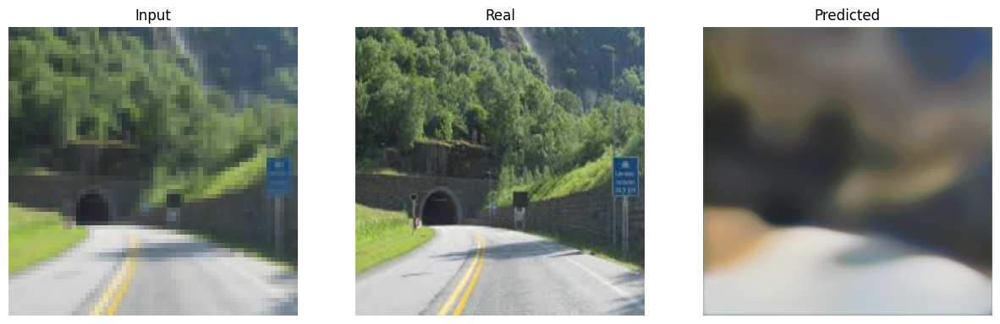

-----------------------------------------------------------
| End of epoch   3 | Time: 39.25s | Train psnr   16.609 | Train Loss    0.206 | Valid psnr   17.658 | Valid Loss    0.176 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | avg_psnr   17.081 | elapsed time 21.51s


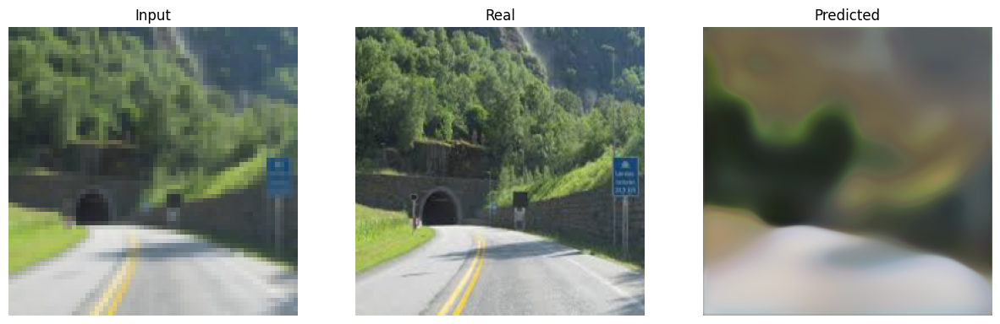

-----------------------------------------------------------
| End of epoch   4 | Time: 40.18s | Train psnr   17.097 | Train Loss    0.194 | Valid psnr   17.741 | Valid Loss    0.172 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | avg_psnr   17.678 | elapsed time 21.89s
-----------------------------------------------------------
| End of epoch   5 | Time: 39.71s | Train psnr   17.434 | Train Loss    0.185 | Valid psnr   15.828 | Valid Loss    0.223 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | avg_psnr   17.616 | elapsed time 21.22s


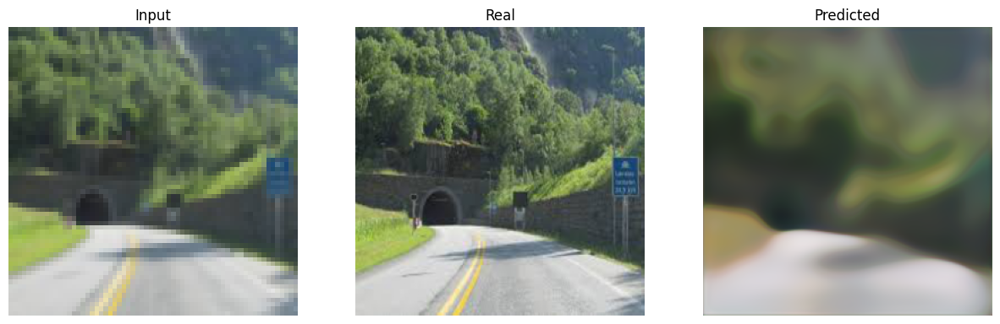

-----------------------------------------------------------
| End of epoch   6 | Time: 40.20s | Train psnr   17.657 | Train Loss    0.177 | Valid psnr   18.130 | Valid Loss    0.164 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | avg_psnr   18.064 | elapsed time 21.27s
-----------------------------------------------------------
| End of epoch   7 | Time: 39.36s | Train psnr   18.050 | Train Loss    0.168 | Valid psnr   17.686 | Valid Loss    0.185 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | avg_psnr   18.107 | elapsed time 21.09s


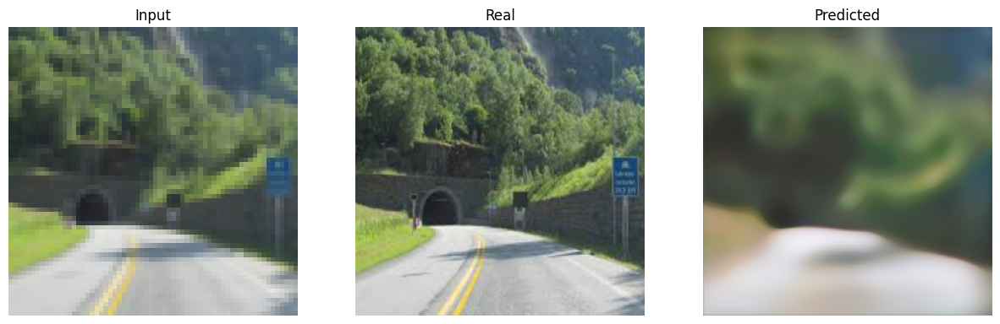

-----------------------------------------------------------
| End of epoch   8 | Time: 40.09s | Train psnr   18.156 | Train Loss    0.167 | Valid psnr   18.151 | Valid Loss    0.168 
-----------------------------------------------------------
| epoch   9 |    50/   86 batches | avg_psnr   18.193 | elapsed time 21.15s


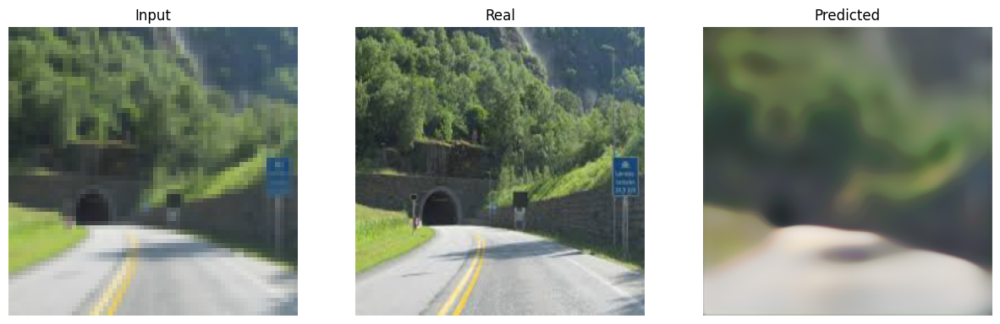

-----------------------------------------------------------
| End of epoch   9 | Time: 39.89s | Train psnr   18.253 | Train Loss    0.164 | Valid psnr   18.567 | Valid Loss    0.156 
-----------------------------------------------------------
| epoch  10 |    50/   86 batches | avg_psnr   18.430 | elapsed time 21.21s
-----------------------------------------------------------
| End of epoch  10 | Time: 39.08s | Train psnr   18.545 | Train Loss    0.158 | Valid psnr   18.533 | Valid Loss    0.155 
-----------------------------------------------------------
| epoch  11 |    50/   86 batches | avg_psnr   18.630 | elapsed time 21.17s
-----------------------------------------------------------
| End of epoch  11 | Time: 39.04s | Train psnr   18.506 | Train Loss    0.159 | Valid psnr   18.424 | Valid Loss    0.157 
-----------------------------------------------------------
| epoch  12 |    50/   86 batches | avg_psnr   18.426 | elapsed time 21.19s


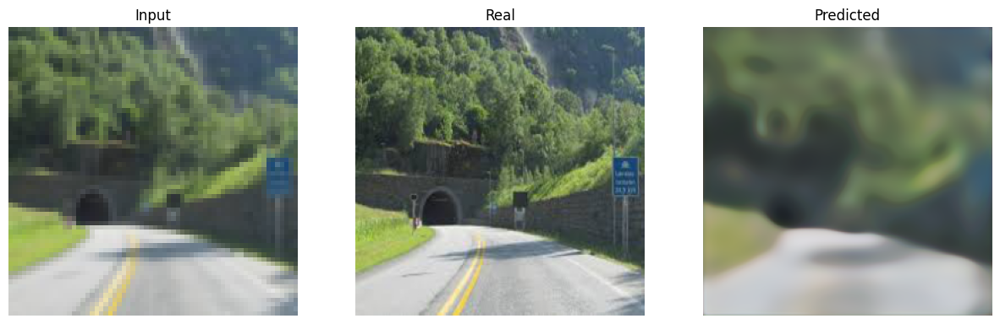

-----------------------------------------------------------
| End of epoch  12 | Time: 39.85s | Train psnr   18.501 | Train Loss    0.160 | Valid psnr   18.907 | Valid Loss    0.148 
-----------------------------------------------------------
| epoch  13 |    50/   86 batches | avg_psnr   18.829 | elapsed time 21.19s
-----------------------------------------------------------
| End of epoch  13 | Time: 39.18s | Train psnr   18.860 | Train Loss    0.150 | Valid psnr   18.686 | Valid Loss    0.153 
-----------------------------------------------------------
| epoch  14 |    50/   86 batches | avg_psnr   18.975 | elapsed time 21.19s
-----------------------------------------------------------
| End of epoch  14 | Time: 39.32s | Train psnr   18.874 | Train Loss    0.151 | Valid psnr   18.721 | Valid Loss    0.158 
-----------------------------------------------------------
| epoch  15 |    50/   86 batches | avg_psnr   18.989 | elapsed time 21.12s
-------------------------------------------

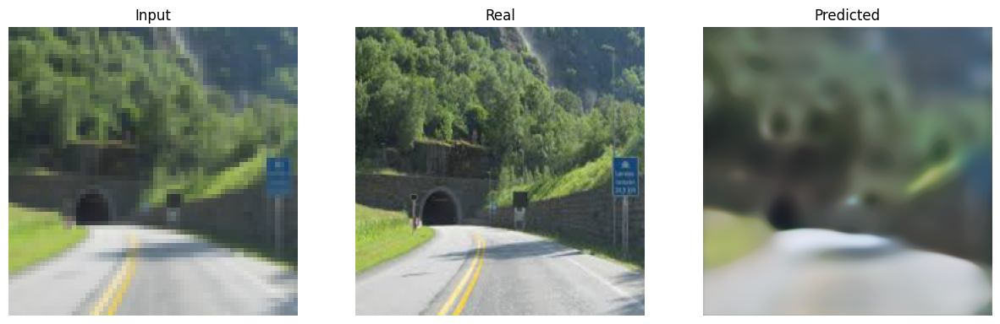

-----------------------------------------------------------
| End of epoch  20 | Time: 39.82s | Train psnr   19.184 | Train Loss    0.146 | Valid psnr   19.452 | Valid Loss    0.136 
-----------------------------------------------------------
| epoch  21 |    50/   86 batches | avg_psnr   19.438 | elapsed time 21.21s
-----------------------------------------------------------
| End of epoch  21 | Time: 39.13s | Train psnr   19.339 | Train Loss    0.142 | Valid psnr   19.406 | Valid Loss    0.143 
-----------------------------------------------------------
| epoch  22 |    50/   86 batches | avg_psnr   19.480 | elapsed time 21.16s
-----------------------------------------------------------
| End of epoch  22 | Time: 39.11s | Train psnr   19.535 | Train Loss    0.139 | Valid psnr   18.974 | Valid Loss    0.154 
-----------------------------------------------------------
| epoch  23 |    50/   86 batches | avg_psnr   19.605 | elapsed time 21.14s


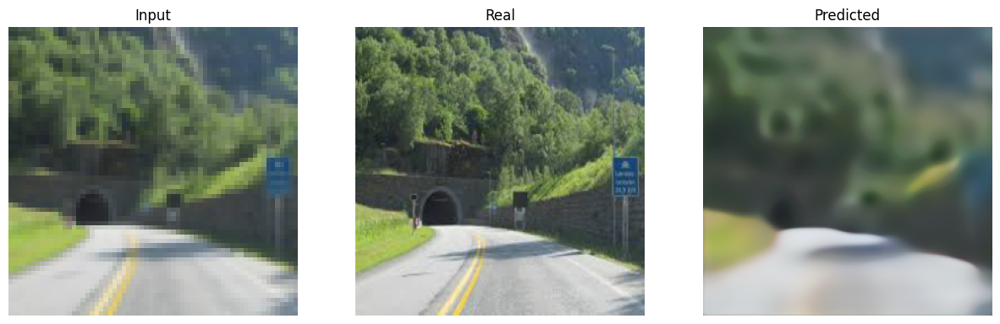

-----------------------------------------------------------
| End of epoch  23 | Time: 40.12s | Train psnr   19.606 | Train Loss    0.137 | Valid psnr   19.591 | Valid Loss    0.134 
-----------------------------------------------------------
| epoch  24 |    50/   86 batches | avg_psnr   19.733 | elapsed time 21.13s
-----------------------------------------------------------
| End of epoch  24 | Time: 39.17s | Train psnr   19.710 | Train Loss    0.136 | Valid psnr   19.225 | Valid Loss    0.138 
-----------------------------------------------------------
| epoch  25 |    50/   86 batches | avg_psnr   19.734 | elapsed time 21.13s


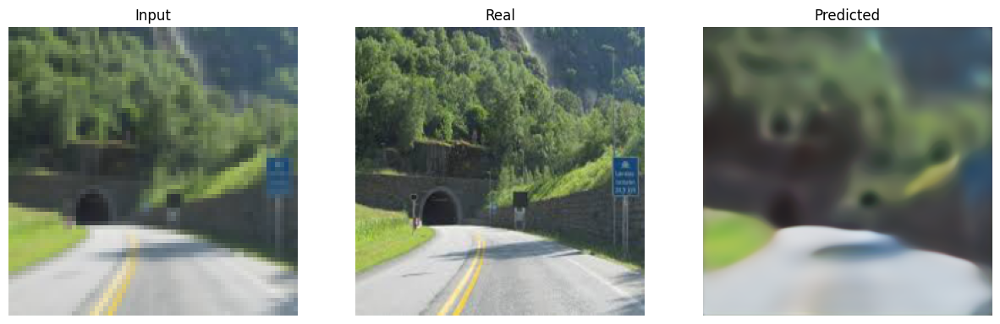

-----------------------------------------------------------
| End of epoch  25 | Time: 39.89s | Train psnr   19.760 | Train Loss    0.135 | Valid psnr   19.716 | Valid Loss    0.135 
-----------------------------------------------------------
| epoch  26 |    50/   86 batches | avg_psnr   19.639 | elapsed time 21.13s
-----------------------------------------------------------
| End of epoch  26 | Time: 39.04s | Train psnr   19.712 | Train Loss    0.136 | Valid psnr   19.247 | Valid Loss    0.142 
-----------------------------------------------------------
| epoch  27 |    50/   86 batches | avg_psnr   19.754 | elapsed time 21.19s


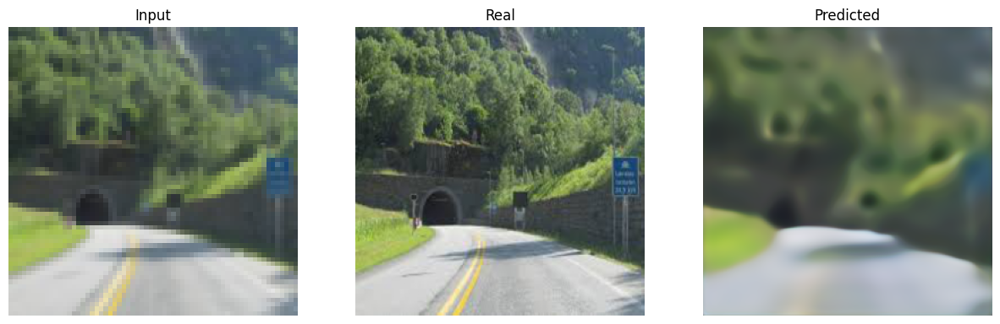

-----------------------------------------------------------
| End of epoch  27 | Time: 39.84s | Train psnr   19.866 | Train Loss    0.133 | Valid psnr   19.753 | Valid Loss    0.132 
-----------------------------------------------------------
| epoch  28 |    50/   86 batches | avg_psnr   19.963 | elapsed time 21.18s
-----------------------------------------------------------
| End of epoch  28 | Time: 39.07s | Train psnr   19.937 | Train Loss    0.131 | Valid psnr   19.033 | Valid Loss    0.148 
-----------------------------------------------------------
| epoch  29 |    50/   86 batches | avg_psnr   19.981 | elapsed time 21.18s


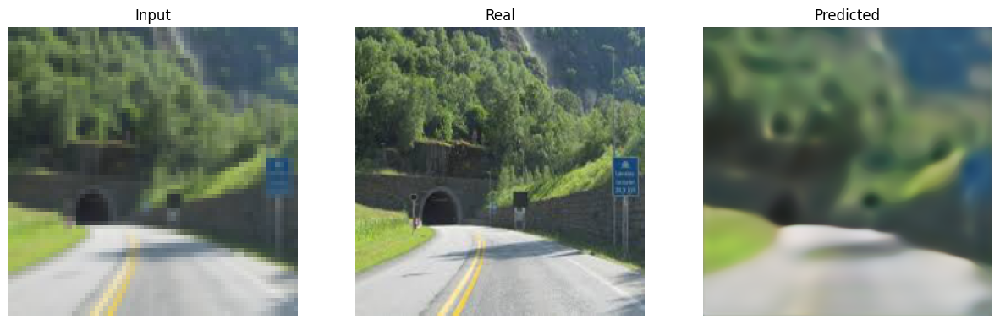

-----------------------------------------------------------
| End of epoch  29 | Time: 39.99s | Train psnr   20.069 | Train Loss    0.129 | Valid psnr   20.112 | Valid Loss    0.127 
-----------------------------------------------------------
| epoch  30 |    50/   86 batches | avg_psnr   20.023 | elapsed time 21.15s
-----------------------------------------------------------
| End of epoch  30 | Time: 39.21s | Train psnr   19.990 | Train Loss    0.132 | Valid psnr   19.176 | Valid Loss    0.145 
-----------------------------------------------------------
| epoch  31 |    50/   86 batches | avg_psnr   20.347 | elapsed time 21.12s
-----------------------------------------------------------
| End of epoch  31 | Time: 39.19s | Train psnr   20.170 | Train Loss    0.128 | Valid psnr   19.976 | Valid Loss    0.129 
-----------------------------------------------------------
| epoch  32 |    50/   86 batches | avg_psnr   20.351 | elapsed time 21.08s
-------------------------------------------

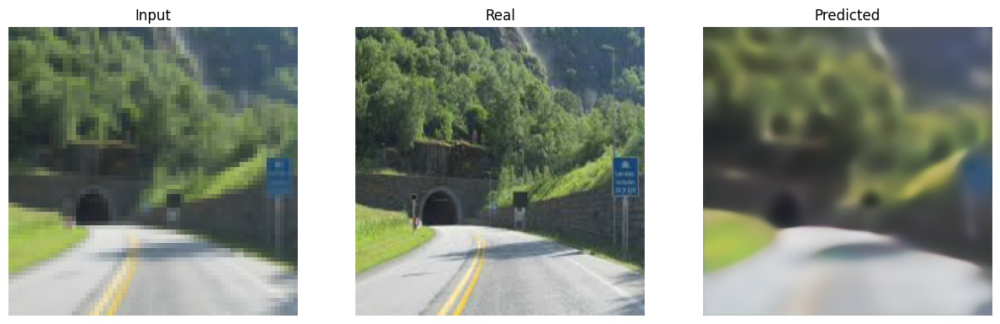

-----------------------------------------------------------
| End of epoch  35 | Time: 39.80s | Train psnr   20.065 | Train Loss    0.130 | Valid psnr   20.175 | Valid Loss    0.128 
-----------------------------------------------------------
| epoch  36 |    50/   86 batches | avg_psnr   20.233 | elapsed time 21.18s


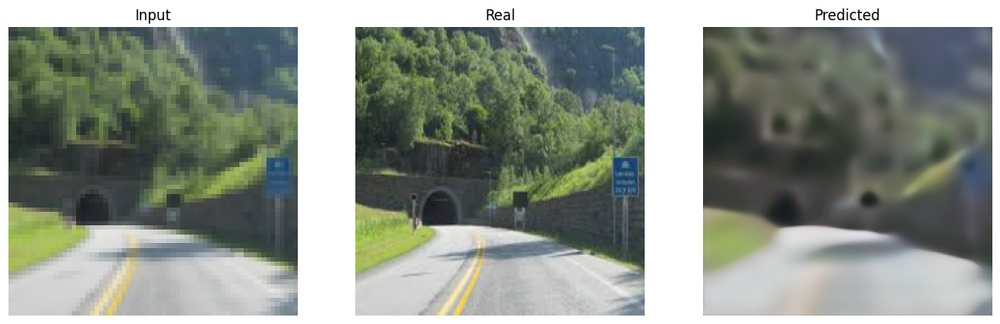

-----------------------------------------------------------
| End of epoch  36 | Time: 39.83s | Train psnr   20.235 | Train Loss    0.127 | Valid psnr   20.205 | Valid Loss    0.128 
-----------------------------------------------------------
| epoch  37 |    50/   86 batches | avg_psnr   20.486 | elapsed time 21.24s
-----------------------------------------------------------
| End of epoch  37 | Time: 39.17s | Train psnr   20.444 | Train Loss    0.123 | Valid psnr   19.988 | Valid Loss    0.126 
-----------------------------------------------------------
| epoch  38 |    50/   86 batches | avg_psnr   20.338 | elapsed time 21.16s
-----------------------------------------------------------
| End of epoch  38 | Time: 39.27s | Train psnr   20.315 | Train Loss    0.124 | Valid psnr   20.073 | Valid Loss    0.130 
-----------------------------------------------------------
| epoch  39 |    50/   86 batches | avg_psnr   20.479 | elapsed time 21.11s
-------------------------------------------

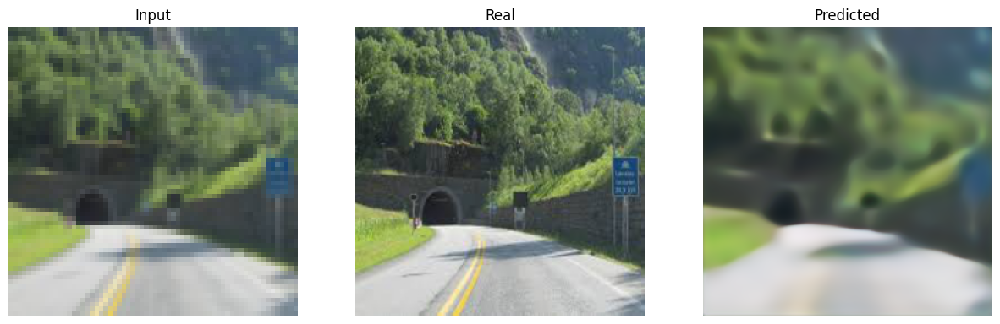

-----------------------------------------------------------
| End of epoch  40 | Time: 39.89s | Train psnr   20.519 | Train Loss    0.122 | Valid psnr   20.278 | Valid Loss    0.124 
-----------------------------------------------------------
| epoch  41 |    50/   86 batches | avg_psnr   20.641 | elapsed time 21.12s


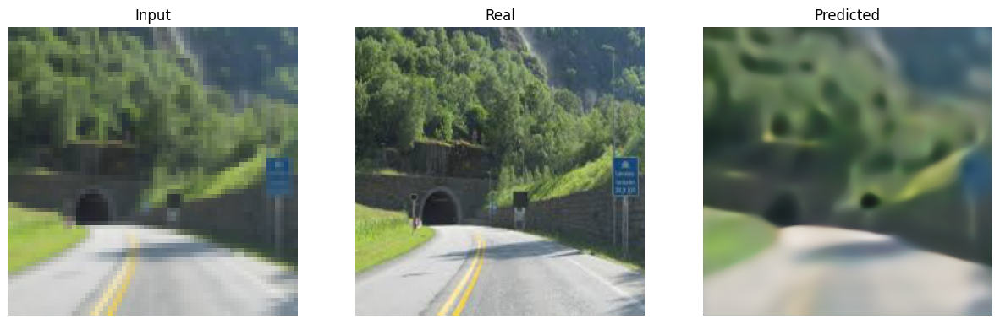

-----------------------------------------------------------
| End of epoch  41 | Time: 39.94s | Train psnr   20.613 | Train Loss    0.120 | Valid psnr   20.420 | Valid Loss    0.127 
-----------------------------------------------------------
| epoch  42 |    50/   86 batches | avg_psnr   20.530 | elapsed time 21.21s
-----------------------------------------------------------
| End of epoch  42 | Time: 39.23s | Train psnr   20.620 | Train Loss    0.121 | Valid psnr   13.310 | Valid Loss    0.301 
-----------------------------------------------------------
| epoch  43 |    50/   86 batches | avg_psnr   19.541 | elapsed time 21.14s
-----------------------------------------------------------
| End of epoch  43 | Time: 38.99s | Train psnr   19.900 | Train Loss    0.134 | Valid psnr   20.324 | Valid Loss    0.125 
-----------------------------------------------------------
| epoch  44 |    50/   86 batches | avg_psnr   20.552 | elapsed time 21.18s
-------------------------------------------

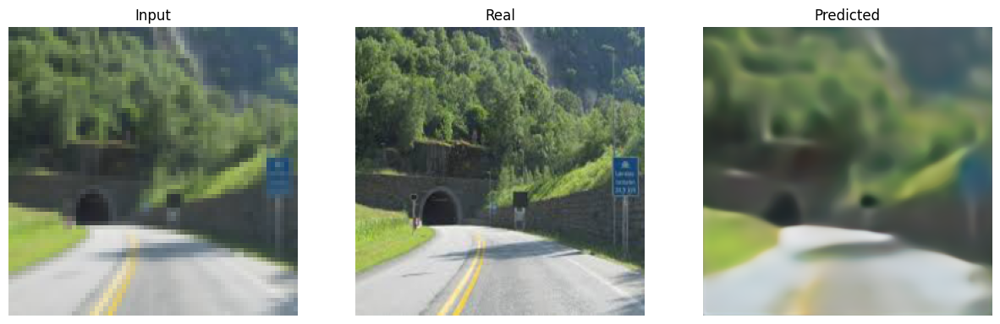

-----------------------------------------------------------
| End of epoch  48 | Time: 40.03s | Train psnr   20.957 | Train Loss    0.115 | Valid psnr   20.469 | Valid Loss    0.125 
-----------------------------------------------------------
| epoch  49 |    50/   86 batches | avg_psnr   20.631 | elapsed time 21.15s
-----------------------------------------------------------
| End of epoch  49 | Time: 39.01s | Train psnr   20.691 | Train Loss    0.119 | Valid psnr   20.383 | Valid Loss    0.126 
-----------------------------------------------------------
| epoch  50 |    50/   86 batches | avg_psnr   20.905 | elapsed time 21.18s


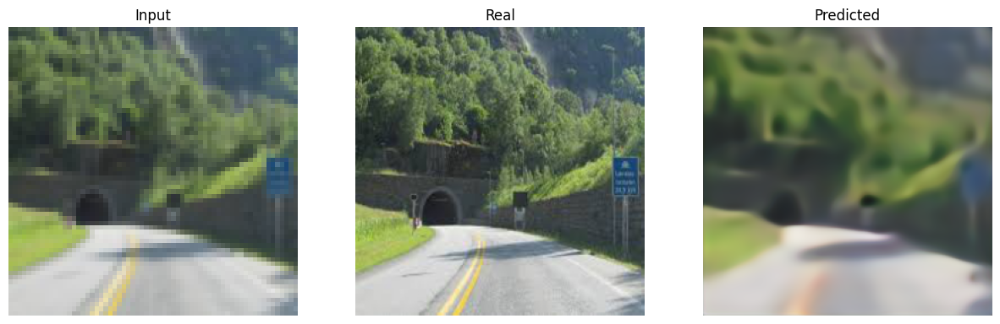

-----------------------------------------------------------
| End of epoch  50 | Time: 39.85s | Train psnr   20.886 | Train Loss    0.116 | Valid psnr   20.532 | Valid Loss    0.121 
-----------------------------------------------------------
| epoch  51 |    50/   86 batches | avg_psnr   20.920 | elapsed time 21.20s
-----------------------------------------------------------
| End of epoch  51 | Time: 39.07s | Train psnr   20.993 | Train Loss    0.114 | Valid psnr   17.038 | Valid Loss    0.196 
-----------------------------------------------------------
| epoch  52 |    50/   86 batches | avg_psnr   20.827 | elapsed time 21.19s
-----------------------------------------------------------
| End of epoch  52 | Time: 39.12s | Train psnr   20.944 | Train Loss    0.115 | Valid psnr   19.700 | Valid Loss    0.129 
-----------------------------------------------------------
| epoch  53 |    50/   86 batches | avg_psnr   20.913 | elapsed time 21.13s


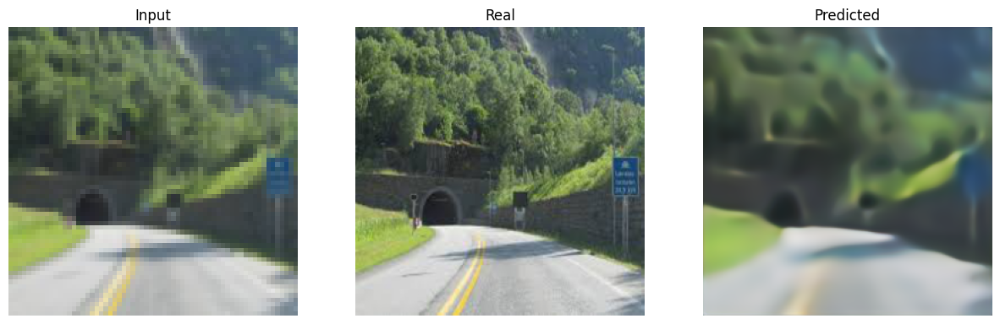

-----------------------------------------------------------
| End of epoch  53 | Time: 40.12s | Train psnr   20.982 | Train Loss    0.114 | Valid psnr   20.671 | Valid Loss    0.116 
-----------------------------------------------------------
| epoch  54 |    50/   86 batches | avg_psnr   20.967 | elapsed time 21.05s
-----------------------------------------------------------
| End of epoch  54 | Time: 39.05s | Train psnr   21.047 | Train Loss    0.114 | Valid psnr   20.351 | Valid Loss    0.128 
-----------------------------------------------------------
| epoch  55 |    50/   86 batches | avg_psnr   21.217 | elapsed time 21.03s
-----------------------------------------------------------
| End of epoch  55 | Time: 39.01s | Train psnr   21.096 | Train Loss    0.113 | Valid psnr   20.381 | Valid Loss    0.123 
-----------------------------------------------------------
| epoch  56 |    50/   86 batches | avg_psnr   21.203 | elapsed time 21.10s
-------------------------------------------

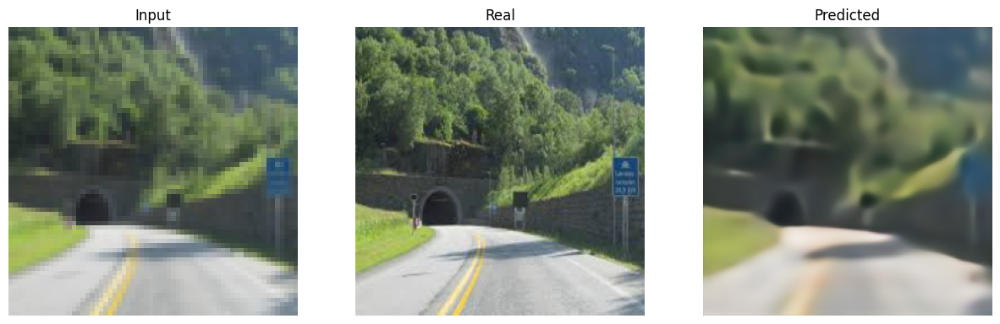

-----------------------------------------------------------
| End of epoch  58 | Time: 39.82s | Train psnr   20.867 | Train Loss    0.116 | Valid psnr   20.684 | Valid Loss    0.115 
-----------------------------------------------------------
| epoch  59 |    50/   86 batches | avg_psnr   21.048 | elapsed time 21.14s


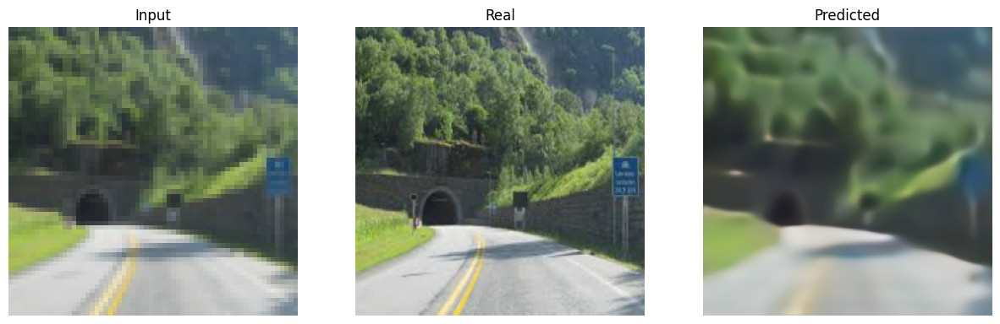

-----------------------------------------------------------
| End of epoch  59 | Time: 39.83s | Train psnr   21.075 | Train Loss    0.114 | Valid psnr   20.795 | Valid Loss    0.118 
-----------------------------------------------------------
| epoch  60 |    50/   86 batches | avg_psnr   20.999 | elapsed time 21.20s
-----------------------------------------------------------
| End of epoch  60 | Time: 39.24s | Train psnr   21.105 | Train Loss    0.112 | Valid psnr   20.144 | Valid Loss    0.129 
-----------------------------------------------------------
| epoch  61 |    50/   86 batches | avg_psnr   21.048 | elapsed time 21.11s
-----------------------------------------------------------
| End of epoch  61 | Time: 39.19s | Train psnr   21.115 | Train Loss    0.114 | Valid psnr   20.549 | Valid Loss    0.119 
-----------------------------------------------------------
| epoch  62 |    50/   86 batches | avg_psnr   21.281 | elapsed time 21.08s
-------------------------------------------

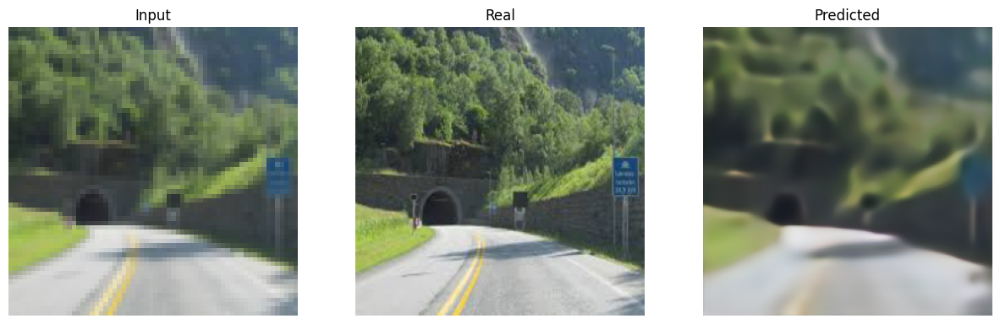

-----------------------------------------------------------
| End of epoch  63 | Time: 39.87s | Train psnr   21.315 | Train Loss    0.109 | Valid psnr   20.954 | Valid Loss    0.115 
-----------------------------------------------------------
| epoch  64 |    50/   86 batches | avg_psnr   21.012 | elapsed time 21.13s
-----------------------------------------------------------
| End of epoch  64 | Time: 39.00s | Train psnr   21.305 | Train Loss    0.110 | Valid psnr   20.716 | Valid Loss    0.124 
-----------------------------------------------------------
| epoch  65 |    50/   86 batches | avg_psnr   21.252 | elapsed time 21.13s
-----------------------------------------------------------
| End of epoch  65 | Time: 38.98s | Train psnr   21.265 | Train Loss    0.111 | Valid psnr   20.743 | Valid Loss    0.114 
-----------------------------------------------------------
| epoch  66 |    50/   86 batches | avg_psnr   21.447 | elapsed time 21.16s
-------------------------------------------

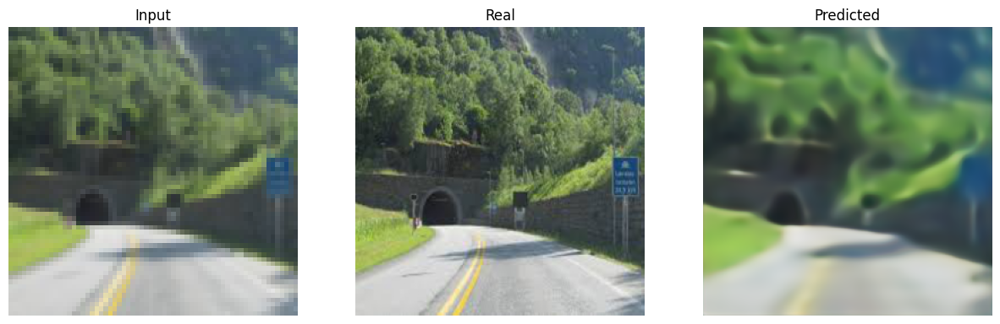

-----------------------------------------------------------
| End of epoch  70 | Time: 39.98s | Train psnr   21.416 | Train Loss    0.108 | Valid psnr   21.012 | Valid Loss    0.115 
-----------------------------------------------------------
| epoch  71 |    50/   86 batches | avg_psnr   21.476 | elapsed time 21.09s
-----------------------------------------------------------
| End of epoch  71 | Time: 39.08s | Train psnr   21.500 | Train Loss    0.108 | Valid psnr   20.682 | Valid Loss    0.113 
-----------------------------------------------------------
| epoch  72 |    50/   86 batches | avg_psnr   21.560 | elapsed time 21.17s
-----------------------------------------------------------
| End of epoch  72 | Time: 39.11s | Train psnr   21.555 | Train Loss    0.106 | Valid psnr   20.561 | Valid Loss    0.119 
-----------------------------------------------------------
| epoch  73 |    50/   86 batches | avg_psnr   21.631 | elapsed time 21.15s
-------------------------------------------

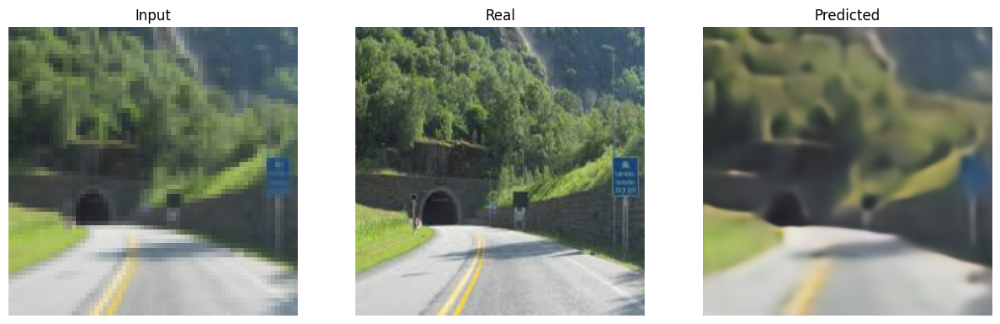

-----------------------------------------------------------
| End of epoch  75 | Time: 39.79s | Train psnr   21.556 | Train Loss    0.107 | Valid psnr   21.226 | Valid Loss    0.110 
-----------------------------------------------------------
| epoch  76 |    50/   86 batches | avg_psnr   21.775 | elapsed time 21.18s
-----------------------------------------------------------
| End of epoch  76 | Time: 39.08s | Train psnr   21.634 | Train Loss    0.106 | Valid psnr   20.733 | Valid Loss    0.113 
-----------------------------------------------------------
| epoch  77 |    50/   86 batches | avg_psnr   21.955 | elapsed time 21.14s


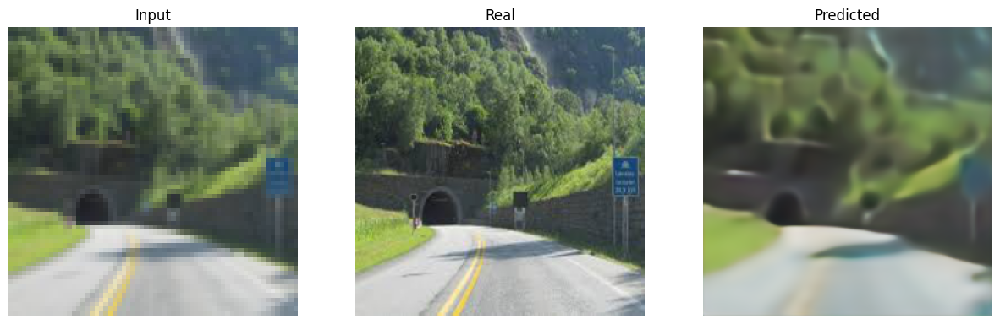

-----------------------------------------------------------
| End of epoch  77 | Time: 40.15s | Train psnr   21.751 | Train Loss    0.104 | Valid psnr   21.249 | Valid Loss    0.110 
-----------------------------------------------------------
| epoch  78 |    50/   86 batches | avg_psnr   21.684 | elapsed time 21.07s
-----------------------------------------------------------
| End of epoch  78 | Time: 39.12s | Train psnr   21.720 | Train Loss    0.104 | Valid psnr   21.216 | Valid Loss    0.109 
-----------------------------------------------------------
| epoch  79 |    50/   86 batches | avg_psnr   21.786 | elapsed time 21.06s


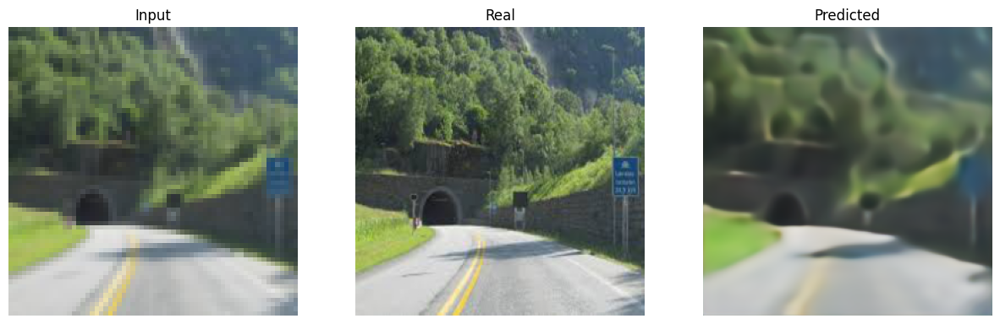

-----------------------------------------------------------
| End of epoch  79 | Time: 39.84s | Train psnr   21.727 | Train Loss    0.104 | Valid psnr   21.366 | Valid Loss    0.107 
-----------------------------------------------------------
| epoch  80 |    50/   86 batches | avg_psnr   21.648 | elapsed time 21.19s
-----------------------------------------------------------
| End of epoch  80 | Time: 39.09s | Train psnr   21.762 | Train Loss    0.104 | Valid psnr   20.974 | Valid Loss    0.115 
-----------------------------------------------------------
| epoch  81 |    50/   86 batches | avg_psnr   21.745 | elapsed time 21.17s
-----------------------------------------------------------
| End of epoch  81 | Time: 39.02s | Train psnr   21.775 | Train Loss    0.103 | Valid psnr   19.458 | Valid Loss    0.141 
-----------------------------------------------------------
| epoch  82 |    50/   86 batches | avg_psnr   21.739 | elapsed time 21.15s
-------------------------------------------

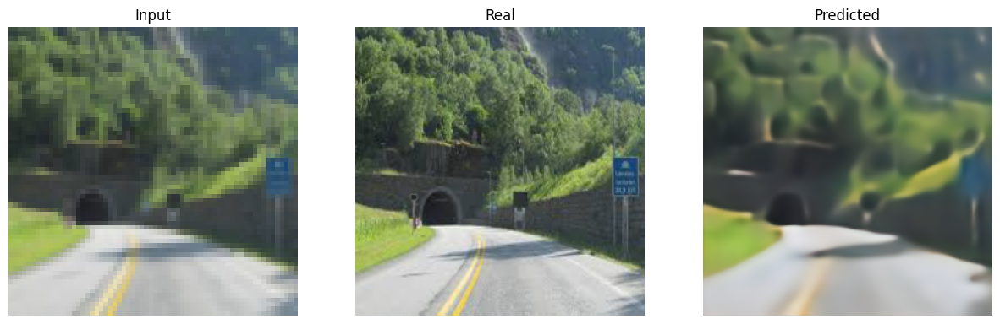

-----------------------------------------------------------
| End of epoch  89 | Time: 39.77s | Train psnr   21.861 | Train Loss    0.103 | Valid psnr   21.424 | Valid Loss    0.105 
-----------------------------------------------------------
| epoch  90 |    50/   86 batches | avg_psnr   21.992 | elapsed time 21.18s
-----------------------------------------------------------
| End of epoch  90 | Time: 39.04s | Train psnr   21.935 | Train Loss    0.102 | Valid psnr   20.213 | Valid Loss    0.119 
-----------------------------------------------------------
| epoch  91 |    50/   86 batches | avg_psnr   21.802 | elapsed time 21.16s


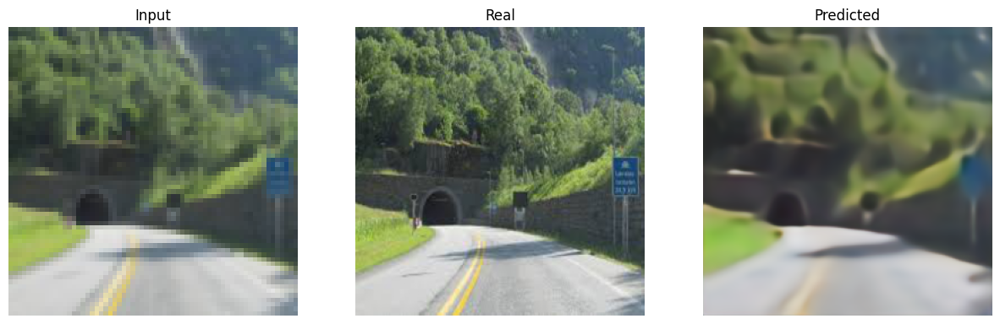

-----------------------------------------------------------
| End of epoch  91 | Time: 40.16s | Train psnr   21.945 | Train Loss    0.101 | Valid psnr   21.454 | Valid Loss    0.106 
-----------------------------------------------------------
| epoch  92 |    50/   86 batches | avg_psnr   22.037 | elapsed time 21.21s
-----------------------------------------------------------
| End of epoch  92 | Time: 39.23s | Train psnr   21.975 | Train Loss    0.101 | Valid psnr   21.029 | Valid Loss    0.112 
-----------------------------------------------------------
| epoch  93 |    50/   86 batches | avg_psnr   21.922 | elapsed time 21.19s
-----------------------------------------------------------
| End of epoch  93 | Time: 39.22s | Train psnr   21.966 | Train Loss    0.101 | Valid psnr   21.439 | Valid Loss    0.106 
-----------------------------------------------------------
| epoch  94 |    50/   86 batches | avg_psnr   22.095 | elapsed time 21.02s
-------------------------------------------

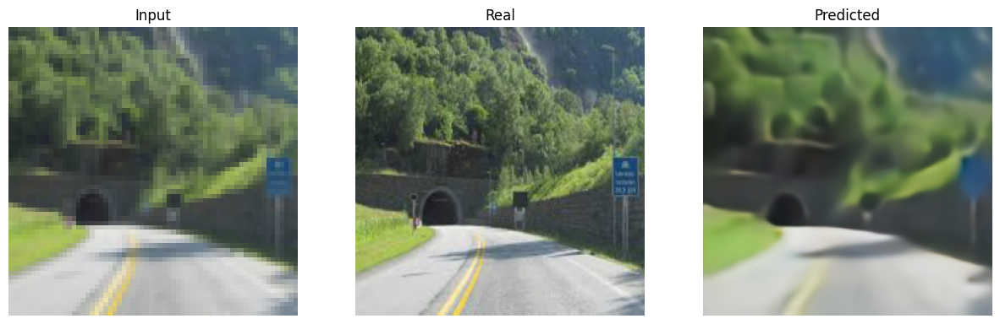

-----------------------------------------------------------
| End of epoch 100 | Time: 39.70s | Train psnr   22.169 | Train Loss    0.098 | Valid psnr   21.544 | Valid Loss    0.103 
-----------------------------------------------------------


<ipython-input-17-c2ed174a60c2>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


In [20]:
import torch.optim as optim

SR_unet_model_noskip = UNet(use_skip=False).to(device)

criterion = nn.L1Loss()
optimizer = optim.Adam(SR_unet_model_noskip.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 100
SR_unet_model_noskip, metrics = train(
    SR_unet_model_noskip, 'SR_unet_model_noskip', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

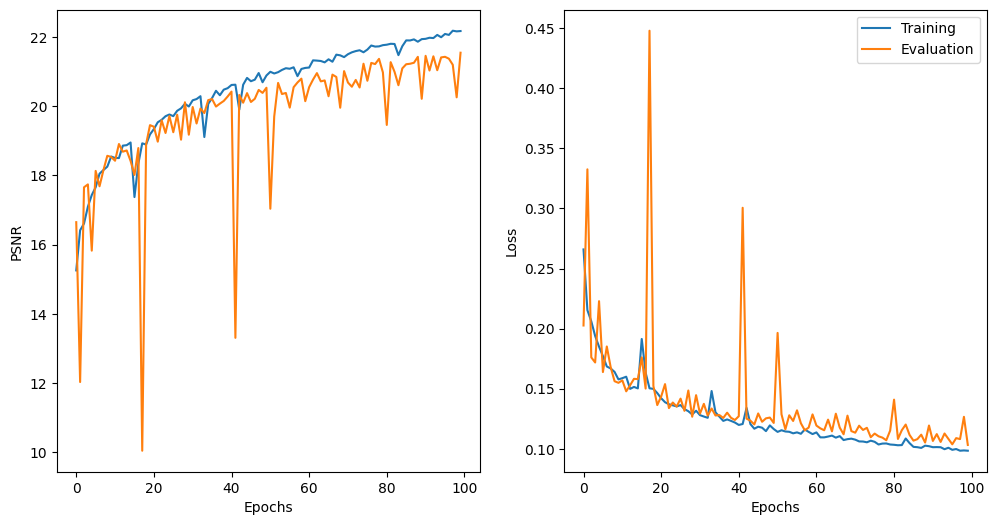

In [21]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [22]:
test_psnr, test_loss = evaluate_epoch(SR_unet_model_noskip, criterion, test_loader, device)
test_psnr, test_loss

(tensor(21.5435, device='cuda:0'), 0.10316399518739093)

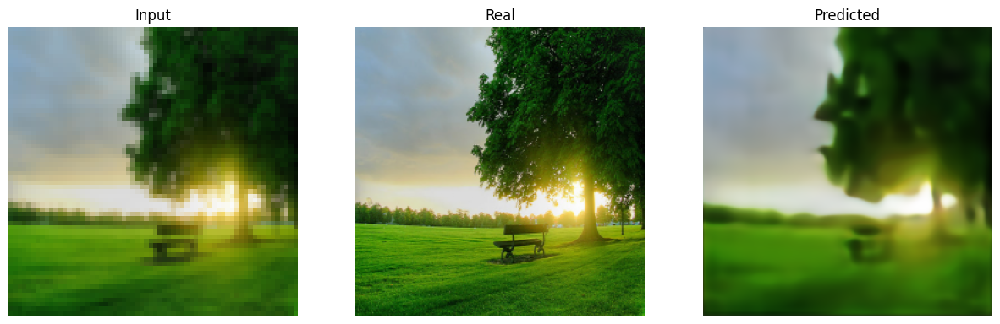

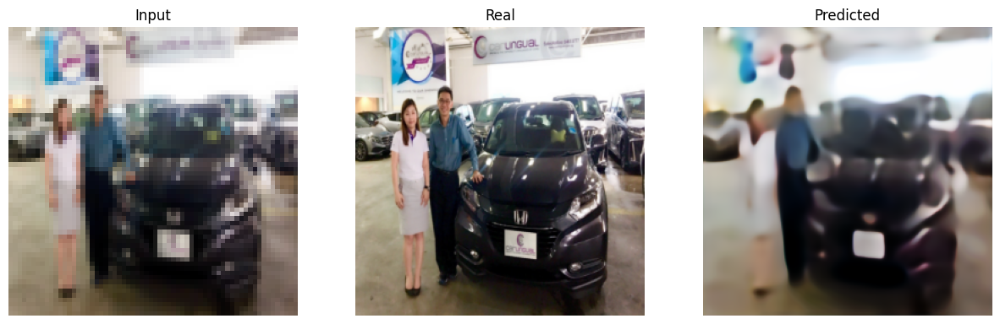

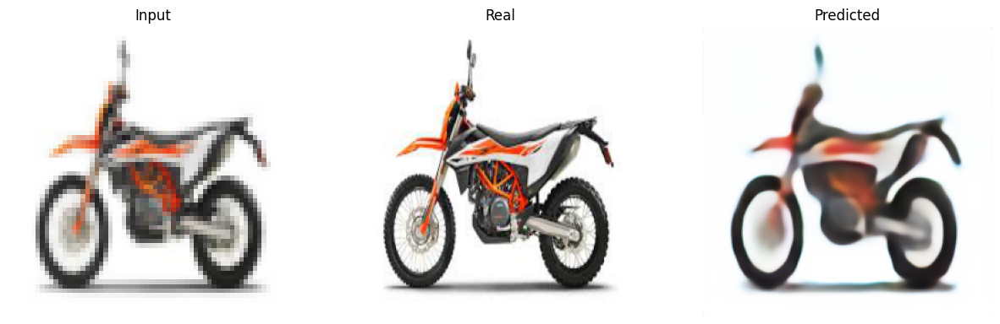

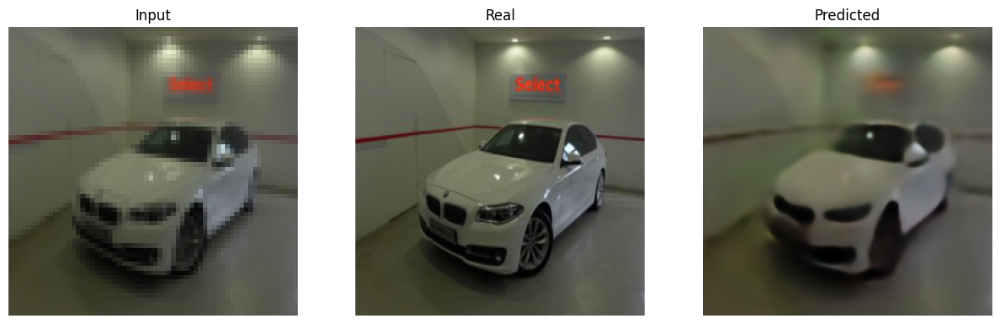

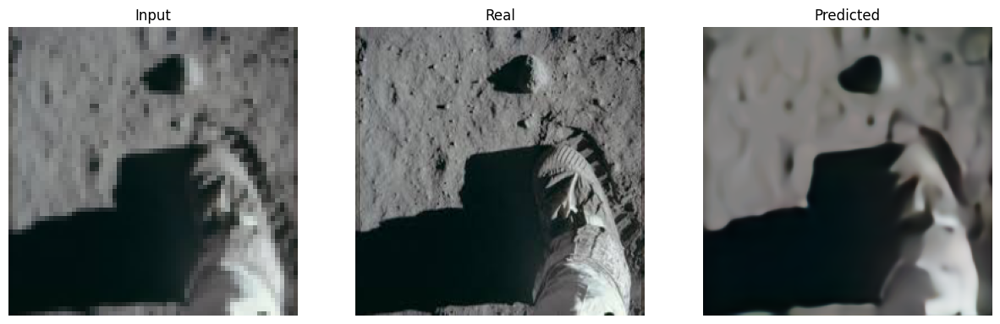

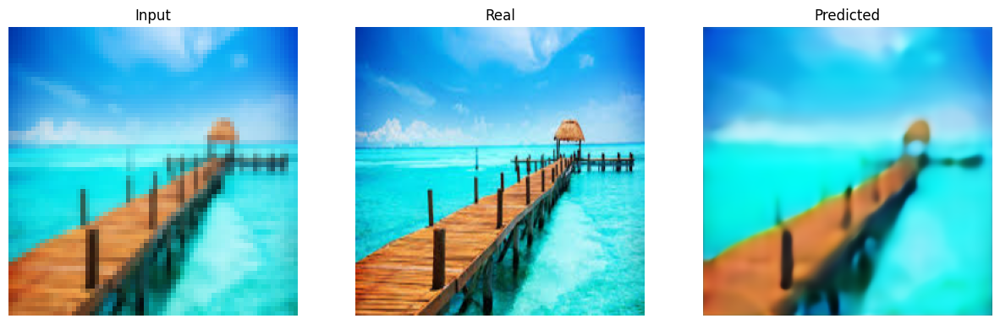

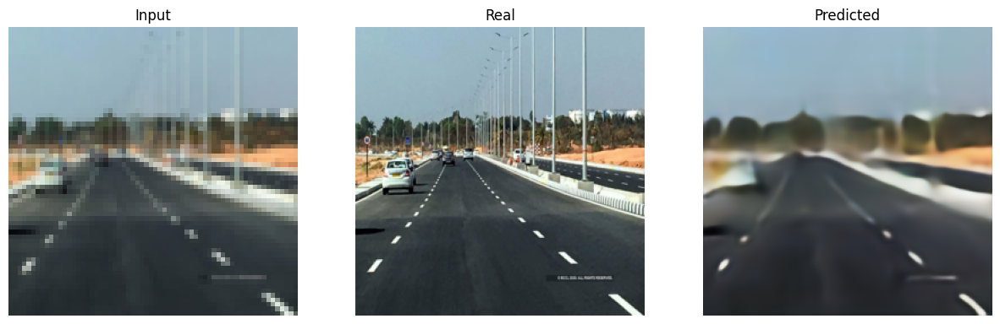

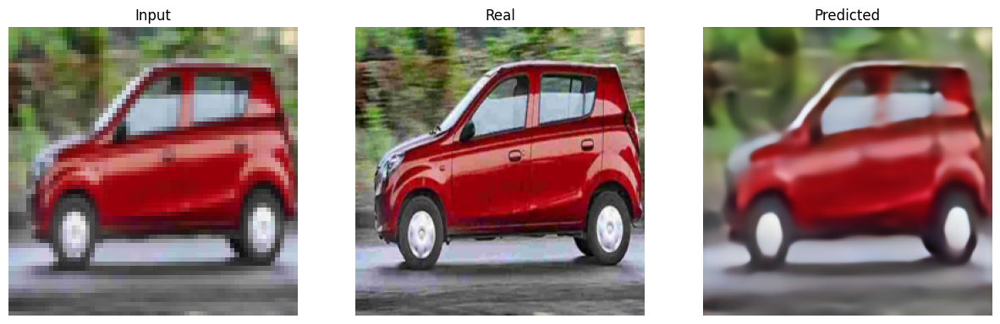

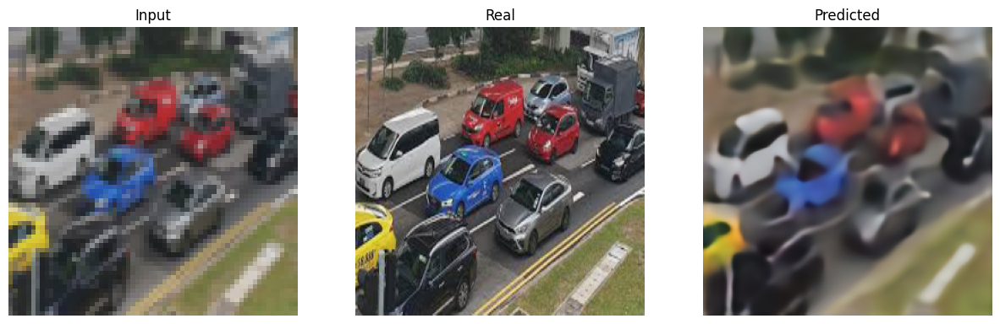

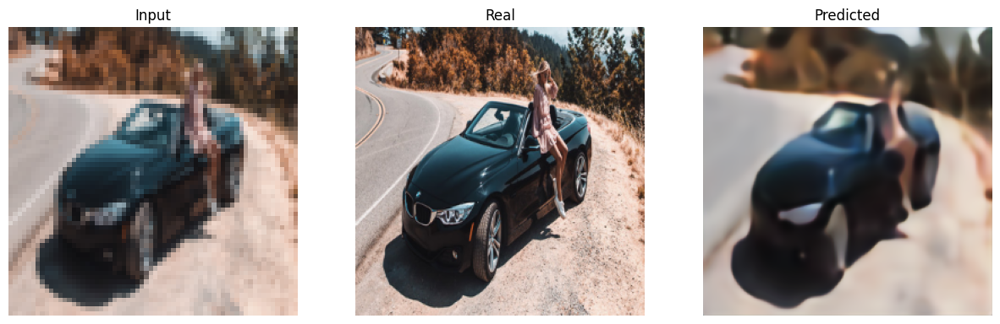

In [23]:
predict_and_display(SR_unet_model_noskip, train_loader, device)

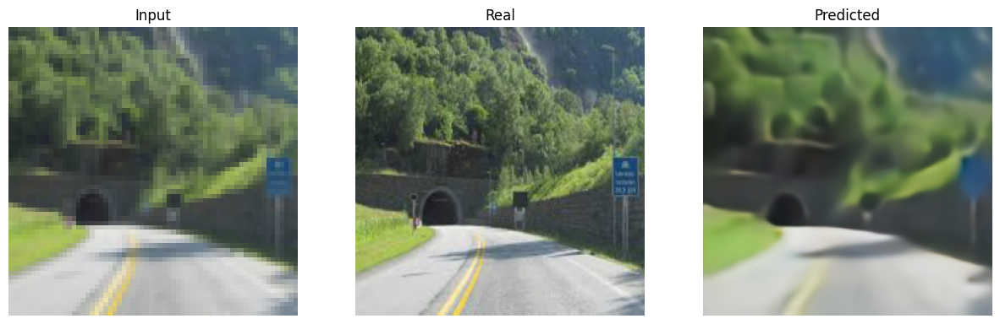

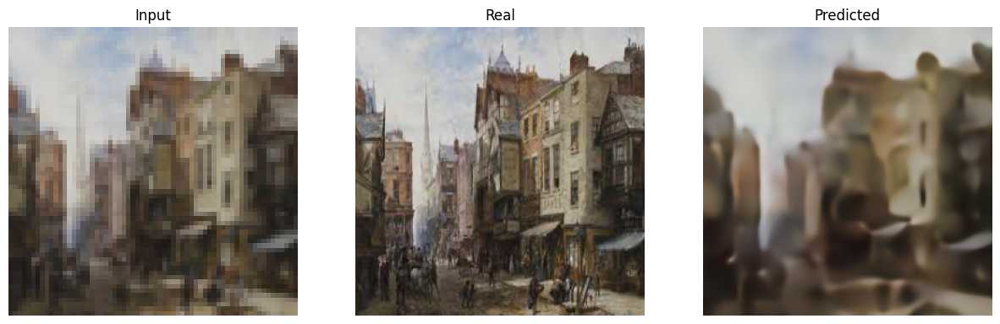

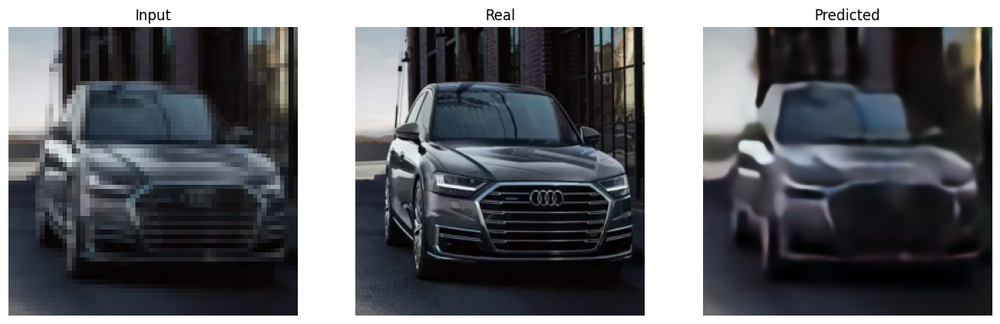

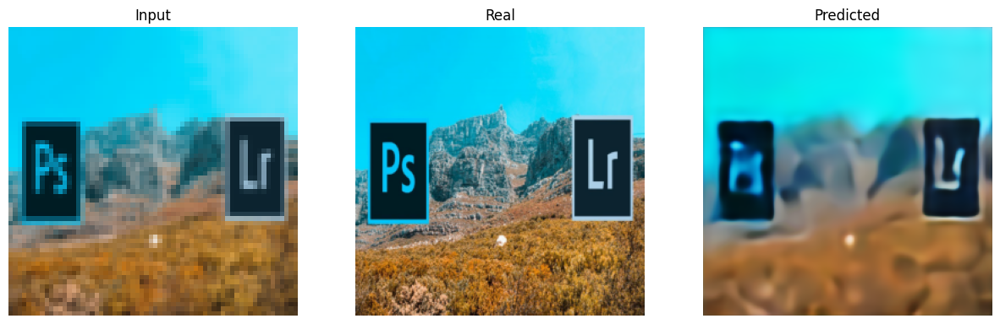

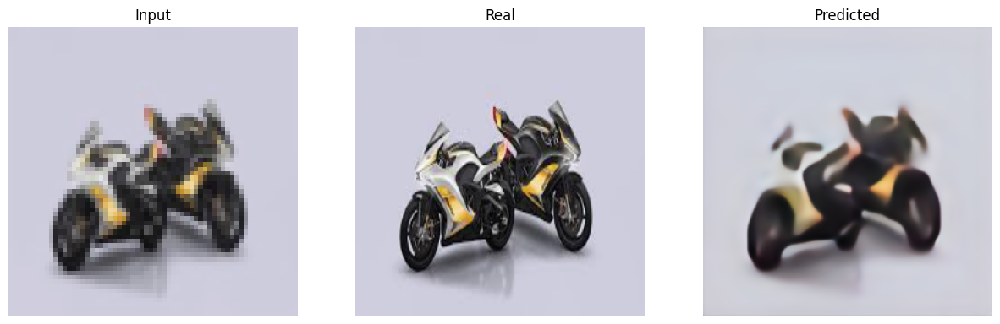

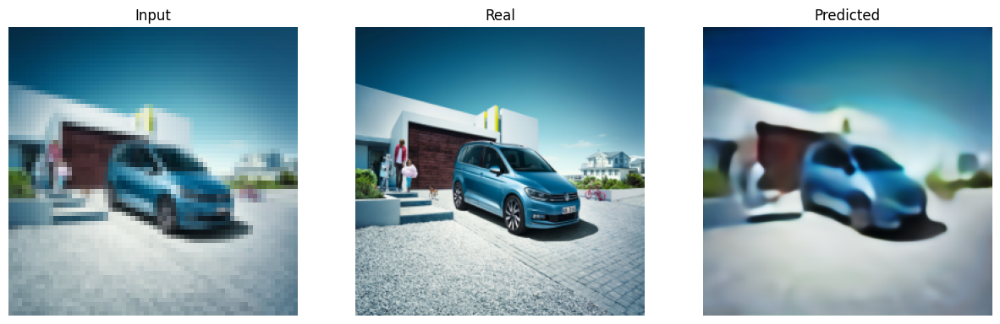

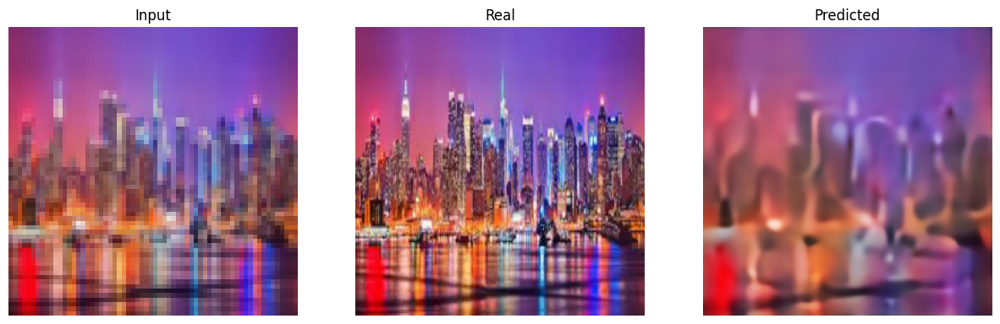

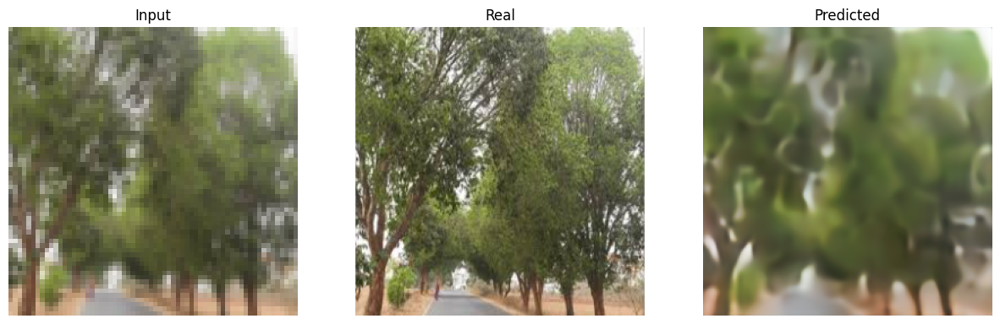

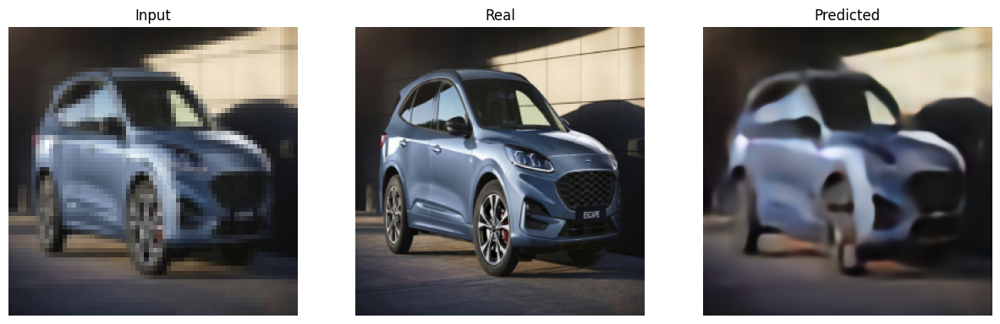

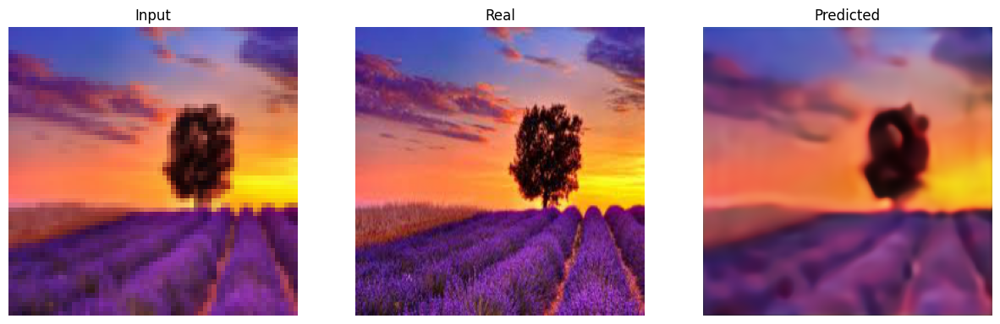

In [24]:
predict_and_display(SR_unet_model_noskip, test_loader, device)

#### Unet

| epoch   1 |    50/   86 batches | avg_psnr   18.305 | elapsed time 27.32s


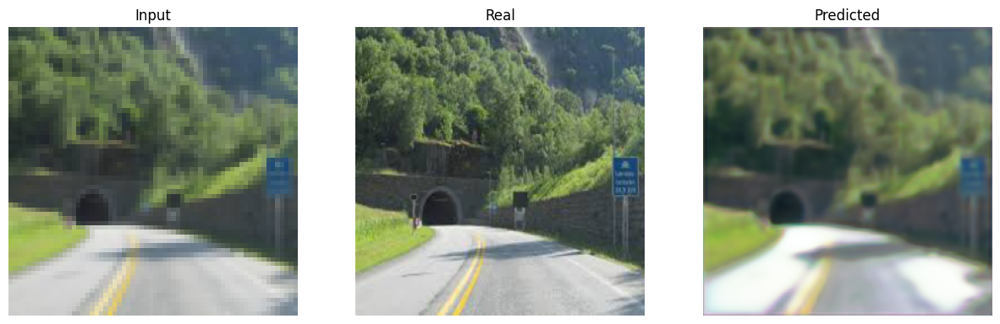

-----------------------------------------------------------
| End of epoch   1 | Time: 50.99s | Train psnr   19.458 | Train Loss    0.171 | Valid psnr   18.377 | Valid Loss    0.153 
-----------------------------------------------------------
| epoch   2 |    50/   86 batches | avg_psnr   21.561 | elapsed time 27.03s


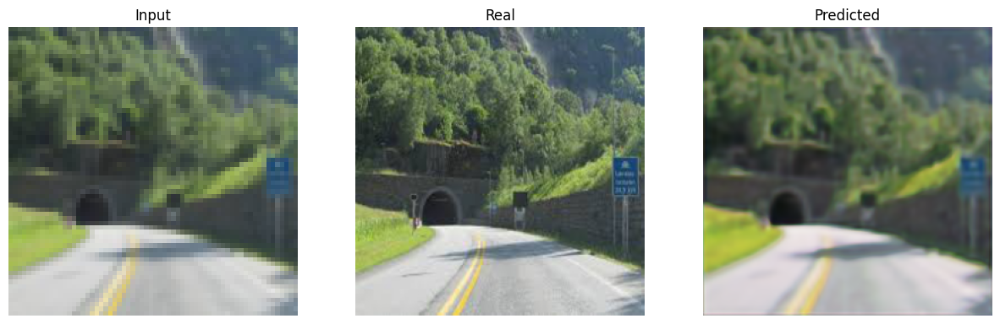

-----------------------------------------------------------
| End of epoch   2 | Time: 50.40s | Train psnr   21.786 | Train Loss    0.120 | Valid psnr   22.095 | Valid Loss    0.105 
-----------------------------------------------------------
| epoch   3 |    50/   86 batches | avg_psnr   22.533 | elapsed time 27.19s


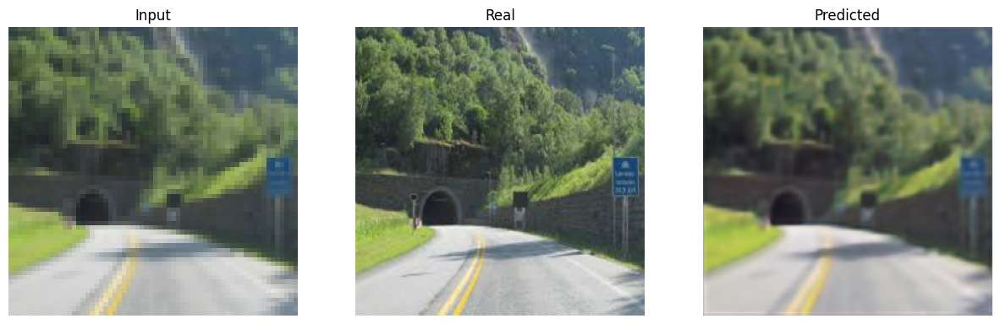

-----------------------------------------------------------
| End of epoch   3 | Time: 50.63s | Train psnr   22.607 | Train Loss    0.107 | Valid psnr   23.667 | Valid Loss    0.085 
-----------------------------------------------------------
| epoch   4 |    50/   86 batches | avg_psnr   22.850 | elapsed time 27.14s


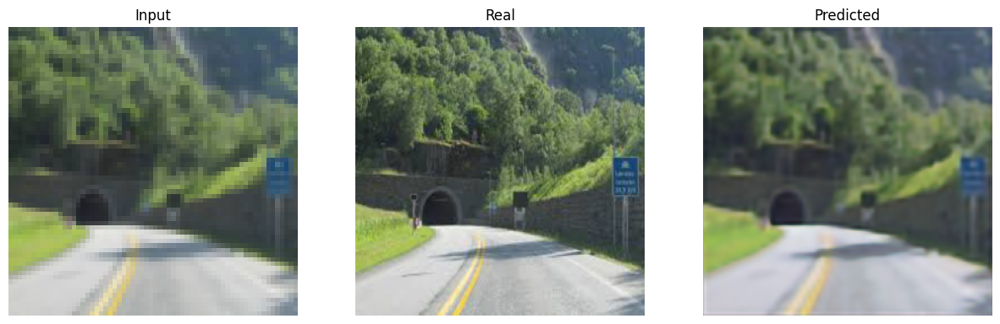

-----------------------------------------------------------
| End of epoch   4 | Time: 50.45s | Train psnr   22.995 | Train Loss    0.101 | Valid psnr   23.887 | Valid Loss    0.083 
-----------------------------------------------------------
| epoch   5 |    50/   86 batches | avg_psnr   23.123 | elapsed time 27.11s


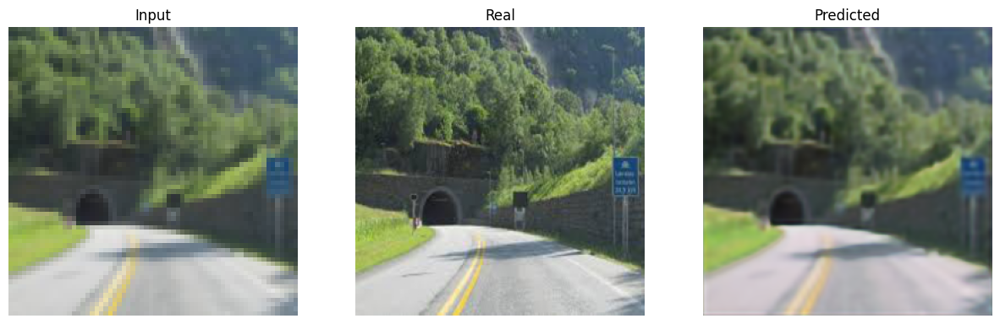

-----------------------------------------------------------
| End of epoch   5 | Time: 50.44s | Train psnr   23.251 | Train Loss    0.097 | Valid psnr   23.903 | Valid Loss    0.083 
-----------------------------------------------------------
| epoch   6 |    50/   86 batches | avg_psnr   23.476 | elapsed time 27.17s


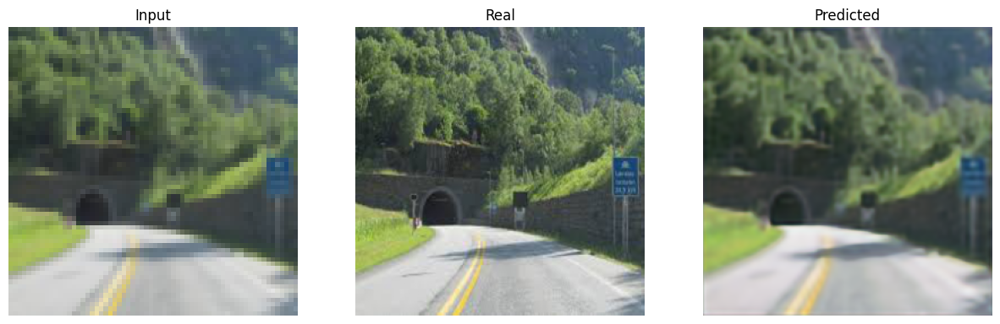

-----------------------------------------------------------
| End of epoch   6 | Time: 50.55s | Train psnr   23.504 | Train Loss    0.093 | Valid psnr   24.262 | Valid Loss    0.078 
-----------------------------------------------------------
| epoch   7 |    50/   86 batches | avg_psnr   23.558 | elapsed time 27.11s


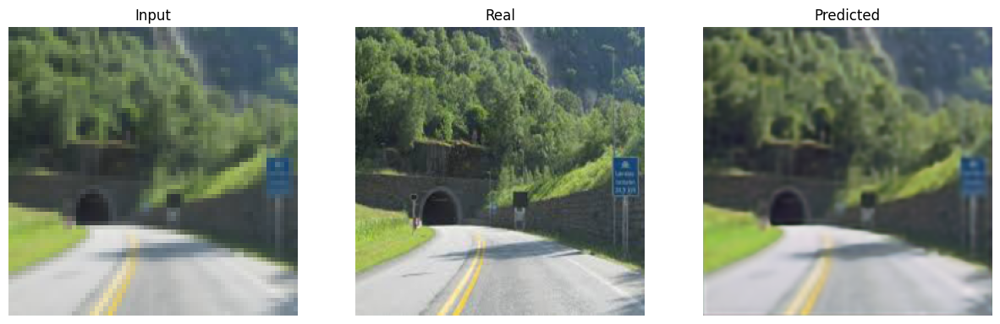

-----------------------------------------------------------
| End of epoch   7 | Time: 50.45s | Train psnr   23.569 | Train Loss    0.092 | Valid psnr   24.327 | Valid Loss    0.076 
-----------------------------------------------------------
| epoch   8 |    50/   86 batches | avg_psnr   23.195 | elapsed time 27.09s


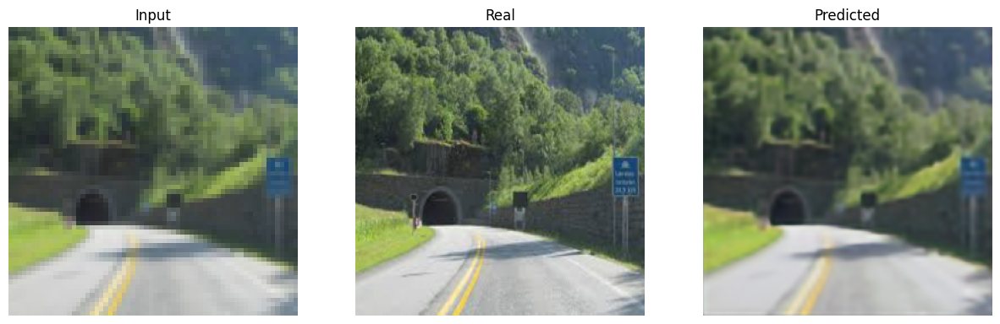

-----------------------------------------------------------
| End of epoch   8 | Time: 50.45s | Train psnr   23.397 | Train Loss    0.094 | Valid psnr   24.344 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch   9 |    50/   86 batches | avg_psnr   23.781 | elapsed time 27.16s
-----------------------------------------------------------
| End of epoch   9 | Time: 49.77s | Train psnr   23.767 | Train Loss    0.089 | Valid psnr   24.341 | Valid Loss    0.076 
-----------------------------------------------------------
| epoch  10 |    50/   86 batches | avg_psnr   23.879 | elapsed time 27.15s
-----------------------------------------------------------
| End of epoch  10 | Time: 49.67s | Train psnr   23.728 | Train Loss    0.089 | Valid psnr   24.138 | Valid Loss    0.080 
-----------------------------------------------------------
| epoch  11 |    50/   86 batches | avg_psnr   23.793 | elapsed time 27.12s


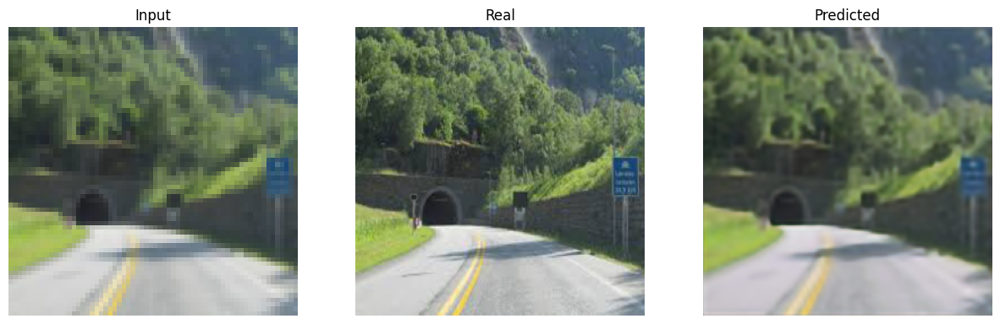

-----------------------------------------------------------
| End of epoch  11 | Time: 50.49s | Train psnr   23.880 | Train Loss    0.087 | Valid psnr   24.562 | Valid Loss    0.074 
-----------------------------------------------------------
| epoch  12 |    50/   86 batches | avg_psnr   23.827 | elapsed time 27.12s
-----------------------------------------------------------
| End of epoch  12 | Time: 49.73s | Train psnr   23.719 | Train Loss    0.089 | Valid psnr   24.255 | Valid Loss    0.078 
-----------------------------------------------------------
| epoch  13 |    50/   86 batches | avg_psnr   23.933 | elapsed time 27.14s
-----------------------------------------------------------
| End of epoch  13 | Time: 49.79s | Train psnr   23.953 | Train Loss    0.086 | Valid psnr   24.366 | Valid Loss    0.078 
-----------------------------------------------------------
| epoch  14 |    50/   86 batches | avg_psnr   24.096 | elapsed time 27.09s
-------------------------------------------

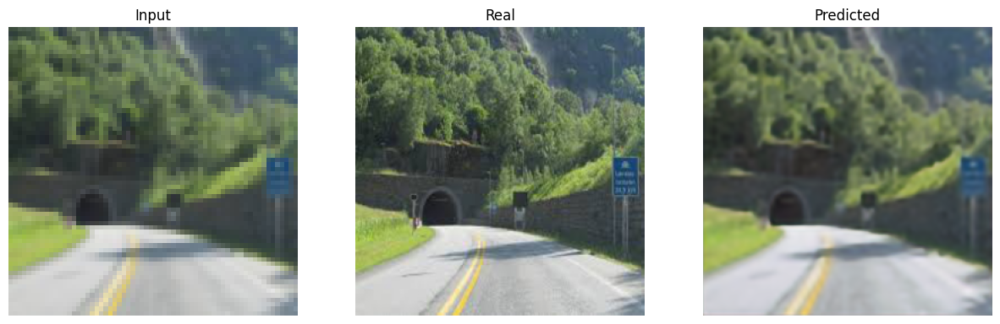

-----------------------------------------------------------
| End of epoch  17 | Time: 50.61s | Train psnr   24.235 | Train Loss    0.082 | Valid psnr   24.751 | Valid Loss    0.071 
-----------------------------------------------------------
| epoch  18 |    50/   86 batches | avg_psnr   24.253 | elapsed time 27.12s


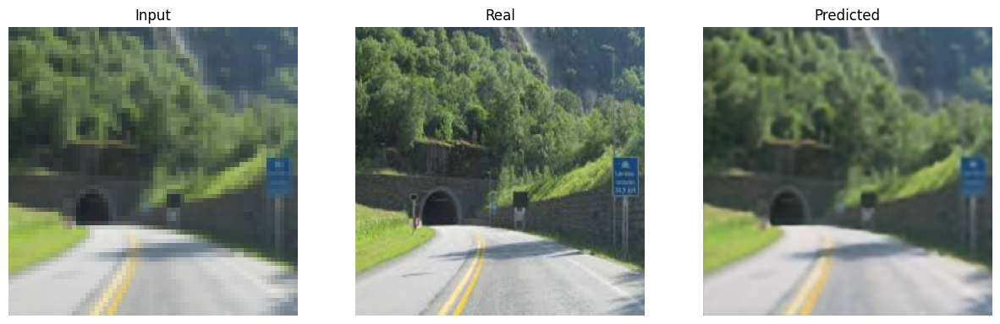

-----------------------------------------------------------
| End of epoch  18 | Time: 50.54s | Train psnr   24.230 | Train Loss    0.082 | Valid psnr   24.822 | Valid Loss    0.070 
-----------------------------------------------------------
| epoch  19 |    50/   86 batches | avg_psnr   24.395 | elapsed time 27.13s
-----------------------------------------------------------
| End of epoch  19 | Time: 49.83s | Train psnr   24.381 | Train Loss    0.080 | Valid psnr   24.599 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch  20 |    50/   86 batches | avg_psnr   24.429 | elapsed time 27.13s
-----------------------------------------------------------
| End of epoch  20 | Time: 49.78s | Train psnr   24.437 | Train Loss    0.079 | Valid psnr   24.687 | Valid Loss    0.073 
-----------------------------------------------------------
| epoch  21 |    50/   86 batches | avg_psnr   24.015 | elapsed time 27.11s
-------------------------------------------

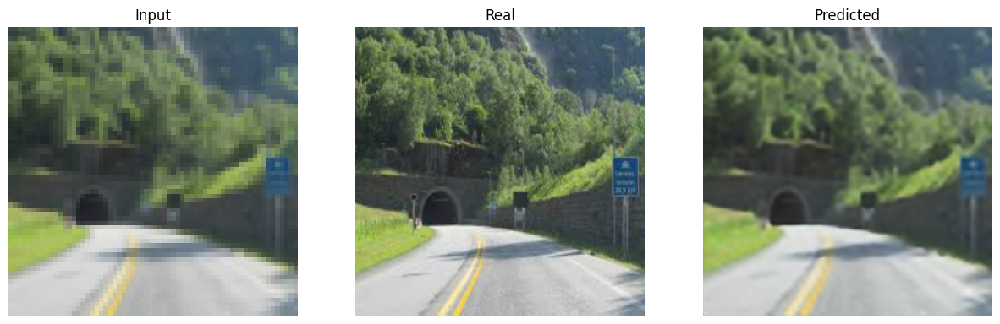

-----------------------------------------------------------
| End of epoch  27 | Time: 50.85s | Train psnr   24.602 | Train Loss    0.077 | Valid psnr   24.969 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  28 |    50/   86 batches | avg_psnr   24.710 | elapsed time 27.17s
-----------------------------------------------------------
| End of epoch  28 | Time: 49.68s | Train psnr   24.614 | Train Loss    0.076 | Valid psnr   24.749 | Valid Loss    0.072 
-----------------------------------------------------------
| epoch  29 |    50/   86 batches | avg_psnr   24.640 | elapsed time 27.21s
-----------------------------------------------------------
| End of epoch  29 | Time: 49.69s | Train psnr   24.730 | Train Loss    0.075 | Valid psnr   24.279 | Valid Loss    0.078 
-----------------------------------------------------------
| epoch  30 |    50/   86 batches | avg_psnr   24.685 | elapsed time 27.19s
-------------------------------------------

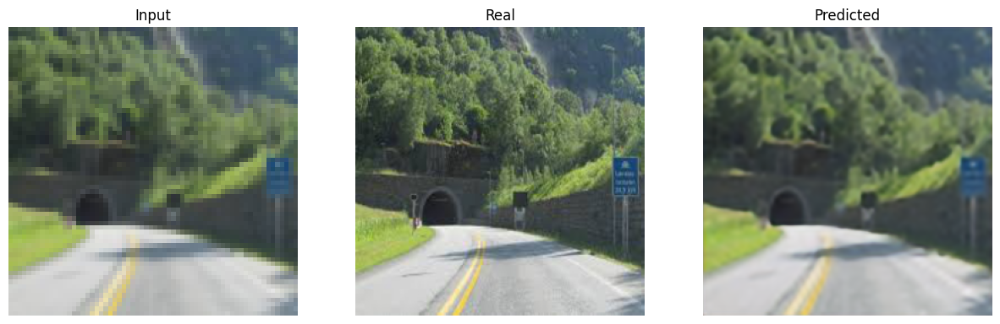

-----------------------------------------------------------
| End of epoch  32 | Time: 50.78s | Train psnr   24.749 | Train Loss    0.075 | Valid psnr   25.007 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  33 |    50/   86 batches | avg_psnr   24.603 | elapsed time 27.18s
-----------------------------------------------------------
| End of epoch  33 | Time: 49.72s | Train psnr   24.737 | Train Loss    0.074 | Valid psnr   24.711 | Valid Loss    0.073 
-----------------------------------------------------------
| epoch  34 |    50/   86 batches | avg_psnr   24.710 | elapsed time 27.16s


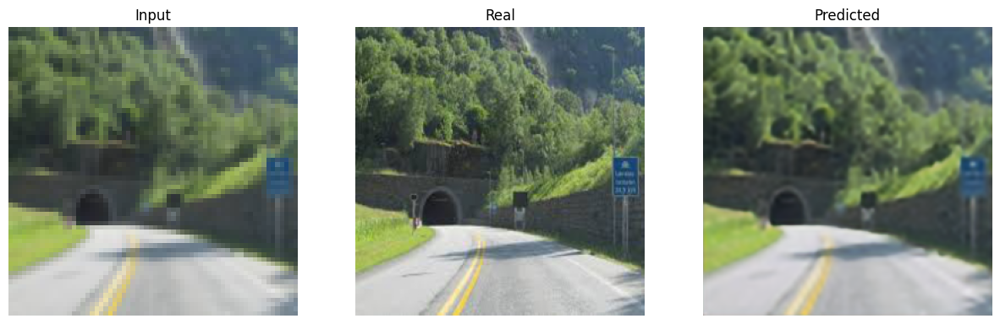

-----------------------------------------------------------
| End of epoch  34 | Time: 50.49s | Train psnr   24.729 | Train Loss    0.074 | Valid psnr   25.017 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  35 |    50/   86 batches | avg_psnr   24.713 | elapsed time 27.14s


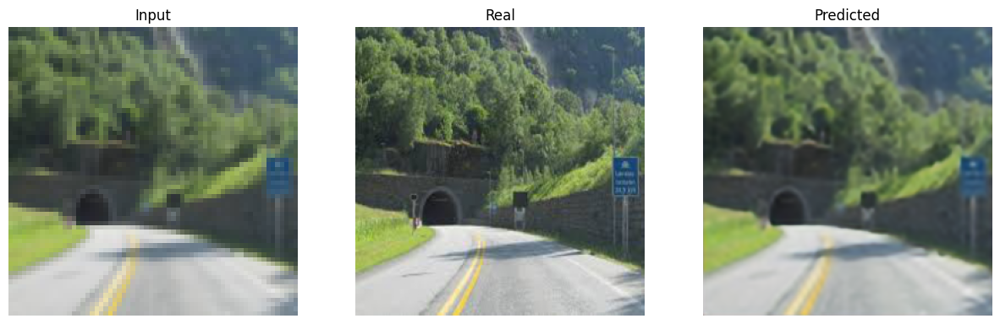

-----------------------------------------------------------
| End of epoch  35 | Time: 50.52s | Train psnr   24.829 | Train Loss    0.073 | Valid psnr   25.028 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  36 |    50/   86 batches | avg_psnr   24.906 | elapsed time 27.13s
-----------------------------------------------------------
| End of epoch  36 | Time: 49.70s | Train psnr   24.860 | Train Loss    0.073 | Valid psnr   24.913 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  37 |    50/   86 batches | avg_psnr   24.669 | elapsed time 27.12s


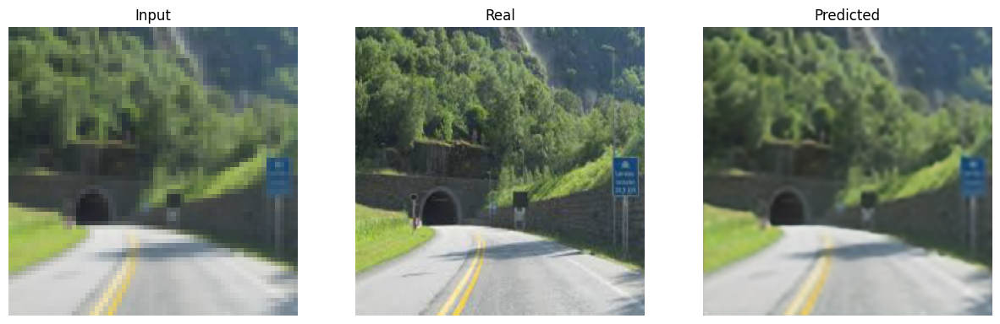

-----------------------------------------------------------
| End of epoch  37 | Time: 50.47s | Train psnr   24.757 | Train Loss    0.074 | Valid psnr   25.068 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  38 |    50/   86 batches | avg_psnr   24.773 | elapsed time 27.11s
-----------------------------------------------------------
| End of epoch  38 | Time: 49.64s | Train psnr   24.721 | Train Loss    0.076 | Valid psnr   25.013 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  39 |    50/   86 batches | avg_psnr   24.702 | elapsed time 27.15s
-----------------------------------------------------------
| End of epoch  39 | Time: 49.67s | Train psnr   24.821 | Train Loss    0.074 | Valid psnr   24.681 | Valid Loss    0.075 
-----------------------------------------------------------
| epoch  40 |    50/   86 batches | avg_psnr   24.875 | elapsed time 27.12s
-------------------------------------------

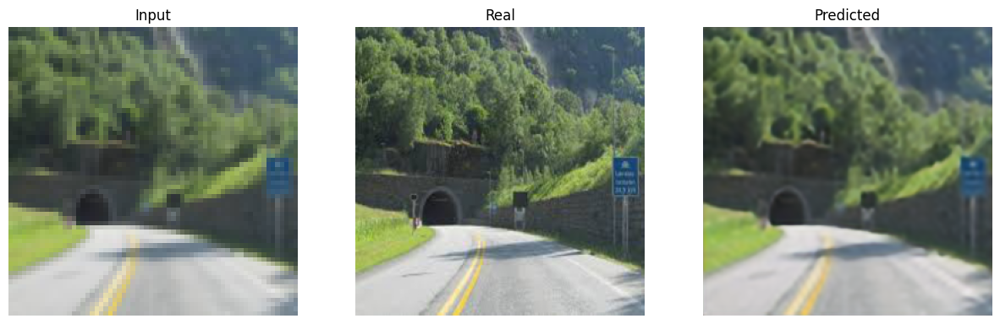

-----------------------------------------------------------
| End of epoch  41 | Time: 50.41s | Train psnr   24.884 | Train Loss    0.073 | Valid psnr   25.070 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  42 |    50/   86 batches | avg_psnr   24.954 | elapsed time 27.14s
-----------------------------------------------------------
| End of epoch  42 | Time: 49.66s | Train psnr   24.985 | Train Loss    0.071 | Valid psnr   25.026 | Valid Loss    0.069 
-----------------------------------------------------------
| epoch  43 |    50/   86 batches | avg_psnr   24.868 | elapsed time 27.12s
-----------------------------------------------------------
| End of epoch  43 | Time: 49.69s | Train psnr   24.935 | Train Loss    0.072 | Valid psnr   25.067 | Valid Loss    0.069 
-----------------------------------------------------------
| epoch  44 |    50/   86 batches | avg_psnr   24.884 | elapsed time 27.10s
-------------------------------------------

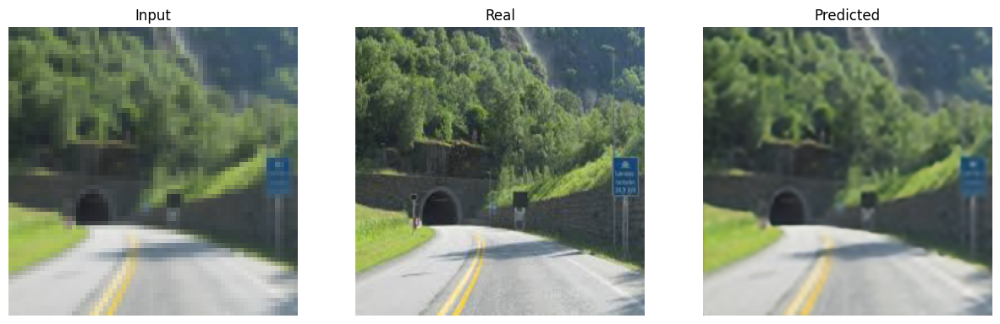

-----------------------------------------------------------
| End of epoch  46 | Time: 50.50s | Train psnr   25.038 | Train Loss    0.071 | Valid psnr   25.200 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  47 |    50/   86 batches | avg_psnr   25.196 | elapsed time 27.12s
-----------------------------------------------------------
| End of epoch  47 | Time: 49.70s | Train psnr   25.037 | Train Loss    0.071 | Valid psnr   24.939 | Valid Loss    0.070 
-----------------------------------------------------------
| epoch  48 |    50/   86 batches | avg_psnr   24.991 | elapsed time 27.12s
-----------------------------------------------------------
| End of epoch  48 | Time: 49.63s | Train psnr   24.994 | Train Loss    0.071 | Valid psnr   24.998 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  49 |    50/   86 batches | avg_psnr   24.984 | elapsed time 27.08s
-------------------------------------------

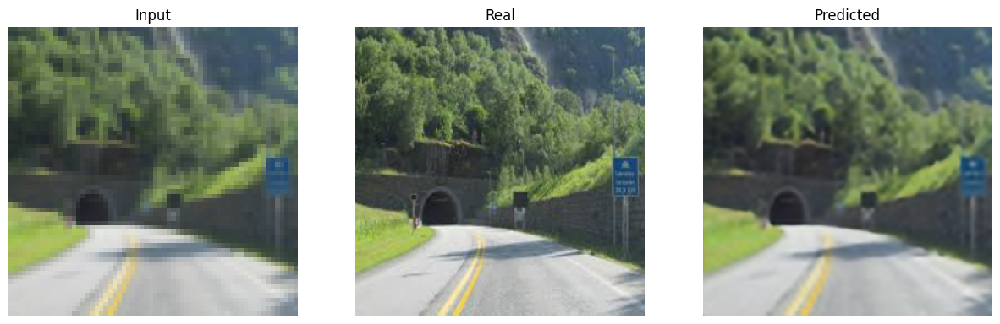

-----------------------------------------------------------
| End of epoch  61 | Time: 50.48s | Train psnr   25.090 | Train Loss    0.070 | Valid psnr   25.229 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  62 |    50/   86 batches | avg_psnr   25.058 | elapsed time 27.18s
-----------------------------------------------------------
| End of epoch  62 | Time: 49.77s | Train psnr   25.093 | Train Loss    0.070 | Valid psnr   25.222 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  63 |    50/   86 batches | avg_psnr   25.153 | elapsed time 27.14s
-----------------------------------------------------------
| End of epoch  63 | Time: 49.69s | Train psnr   25.115 | Train Loss    0.070 | Valid psnr   25.134 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  64 |    50/   86 batches | avg_psnr   25.265 | elapsed time 27.11s
-------------------------------------------

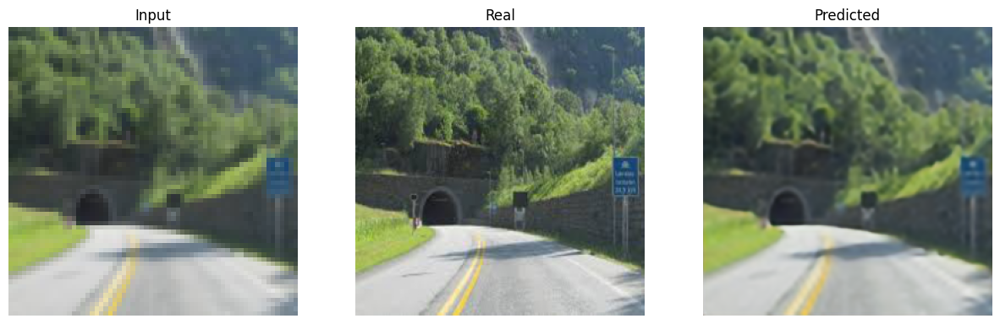

-----------------------------------------------------------
| End of epoch  65 | Time: 50.54s | Train psnr   25.050 | Train Loss    0.071 | Valid psnr   25.239 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  66 |    50/   86 batches | avg_psnr   25.201 | elapsed time 27.06s
-----------------------------------------------------------
| End of epoch  66 | Time: 49.64s | Train psnr   25.175 | Train Loss    0.069 | Valid psnr   25.208 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  67 |    50/   86 batches | avg_psnr   25.330 | elapsed time 27.10s


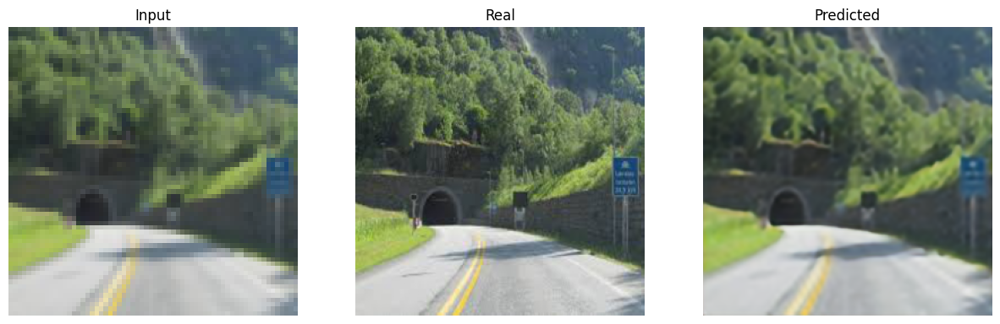

-----------------------------------------------------------
| End of epoch  67 | Time: 50.52s | Train psnr   25.211 | Train Loss    0.069 | Valid psnr   25.249 | Valid Loss    0.065 
-----------------------------------------------------------
| epoch  68 |    50/   86 batches | avg_psnr   25.213 | elapsed time 27.09s
-----------------------------------------------------------
| End of epoch  68 | Time: 49.68s | Train psnr   25.165 | Train Loss    0.069 | Valid psnr   25.241 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  69 |    50/   86 batches | avg_psnr   25.175 | elapsed time 27.11s


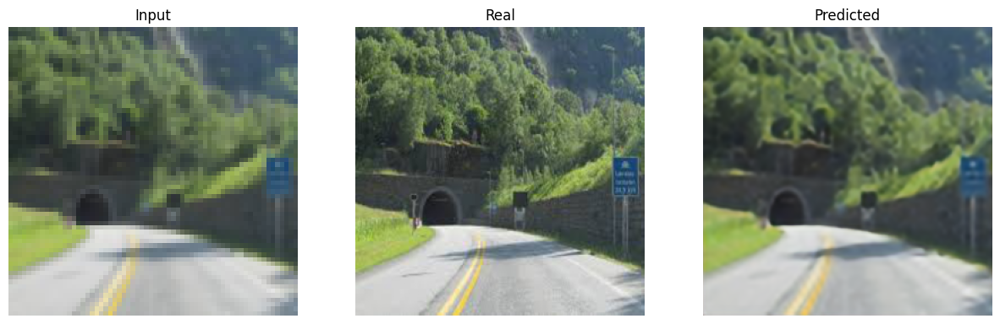

-----------------------------------------------------------
| End of epoch  69 | Time: 50.51s | Train psnr   25.288 | Train Loss    0.067 | Valid psnr   25.313 | Valid Loss    0.064 
-----------------------------------------------------------
| epoch  70 |    50/   86 batches | avg_psnr   25.339 | elapsed time 27.09s
-----------------------------------------------------------
| End of epoch  70 | Time: 49.69s | Train psnr   25.251 | Train Loss    0.068 | Valid psnr   25.158 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  71 |    50/   86 batches | avg_psnr   25.301 | elapsed time 27.13s
-----------------------------------------------------------
| End of epoch  71 | Time: 49.75s | Train psnr   25.280 | Train Loss    0.067 | Valid psnr   25.149 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  72 |    50/   86 batches | avg_psnr   25.225 | elapsed time 27.10s
-------------------------------------------

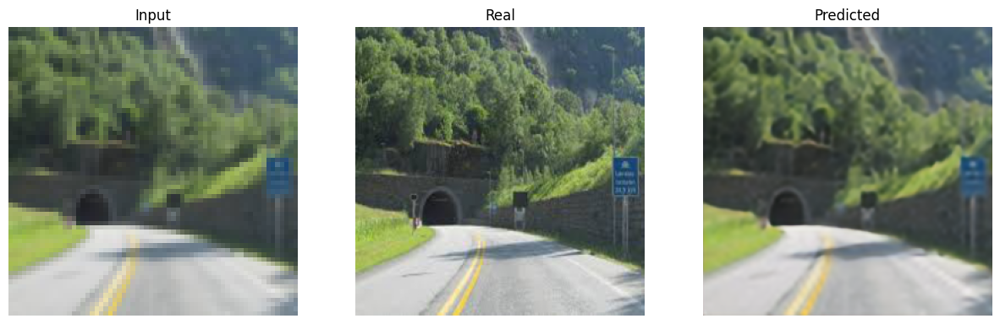

-----------------------------------------------------------
| End of epoch  76 | Time: 50.73s | Train psnr   25.329 | Train Loss    0.067 | Valid psnr   25.318 | Valid Loss    0.065 
-----------------------------------------------------------
| epoch  77 |    50/   86 batches | avg_psnr   25.234 | elapsed time 27.18s
-----------------------------------------------------------
| End of epoch  77 | Time: 49.85s | Train psnr   25.210 | Train Loss    0.069 | Valid psnr   25.119 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  78 |    50/   86 batches | avg_psnr   25.160 | elapsed time 27.20s


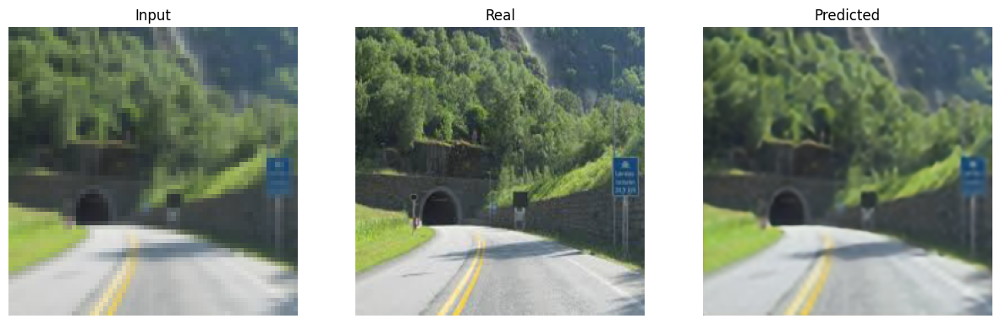

-----------------------------------------------------------
| End of epoch  78 | Time: 50.90s | Train psnr   25.273 | Train Loss    0.068 | Valid psnr   25.365 | Valid Loss    0.065 
-----------------------------------------------------------
| epoch  79 |    50/   86 batches | avg_psnr   25.205 | elapsed time 27.07s
-----------------------------------------------------------
| End of epoch  79 | Time: 49.81s | Train psnr   25.333 | Train Loss    0.067 | Valid psnr   25.068 | Valid Loss    0.069 
-----------------------------------------------------------
| epoch  80 |    50/   86 batches | avg_psnr   25.226 | elapsed time 27.29s
-----------------------------------------------------------
| End of epoch  80 | Time: 49.98s | Train psnr   25.360 | Train Loss    0.067 | Valid psnr   25.228 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  81 |    50/   86 batches | avg_psnr   25.196 | elapsed time 27.22s
-------------------------------------------

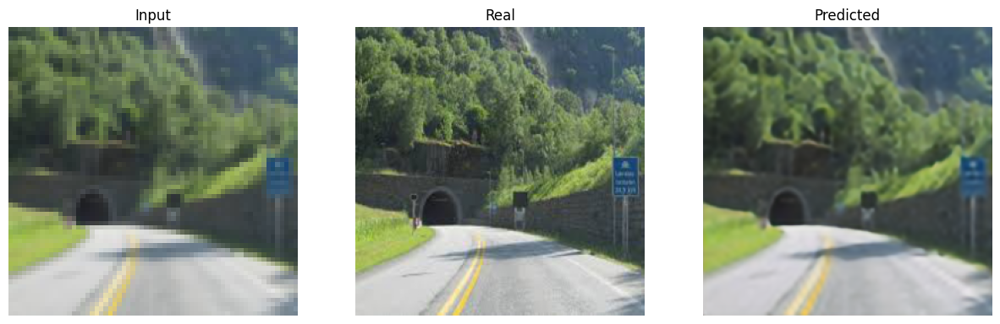

-----------------------------------------------------------
| End of epoch  84 | Time: 50.83s | Train psnr   25.350 | Train Loss    0.067 | Valid psnr   25.413 | Valid Loss    0.064 
-----------------------------------------------------------
| epoch  85 |    50/   86 batches | avg_psnr   25.168 | elapsed time 27.31s
-----------------------------------------------------------
| End of epoch  85 | Time: 50.01s | Train psnr   25.376 | Train Loss    0.067 | Valid psnr   25.306 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  86 |    50/   86 batches | avg_psnr   25.379 | elapsed time 27.17s
-----------------------------------------------------------
| End of epoch  86 | Time: 49.78s | Train psnr   25.380 | Train Loss    0.066 | Valid psnr   25.239 | Valid Loss    0.068 
-----------------------------------------------------------
| epoch  87 |    50/   86 batches | avg_psnr   25.400 | elapsed time 27.16s
-------------------------------------------

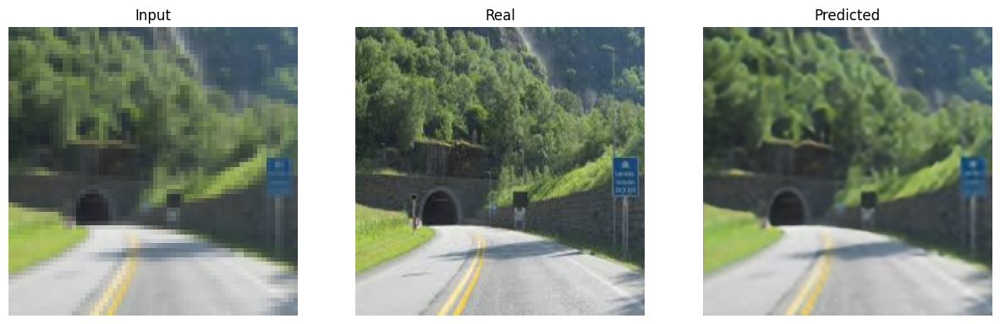

-----------------------------------------------------------
| End of epoch  89 | Time: 50.78s | Train psnr   25.414 | Train Loss    0.066 | Valid psnr   25.416 | Valid Loss    0.065 
-----------------------------------------------------------
| epoch  90 |    50/   86 batches | avg_psnr   25.351 | elapsed time 27.32s
-----------------------------------------------------------
| End of epoch  90 | Time: 50.00s | Train psnr   25.444 | Train Loss    0.066 | Valid psnr   25.393 | Valid Loss    0.065 
-----------------------------------------------------------
| epoch  91 |    50/   86 batches | avg_psnr   25.320 | elapsed time 27.18s


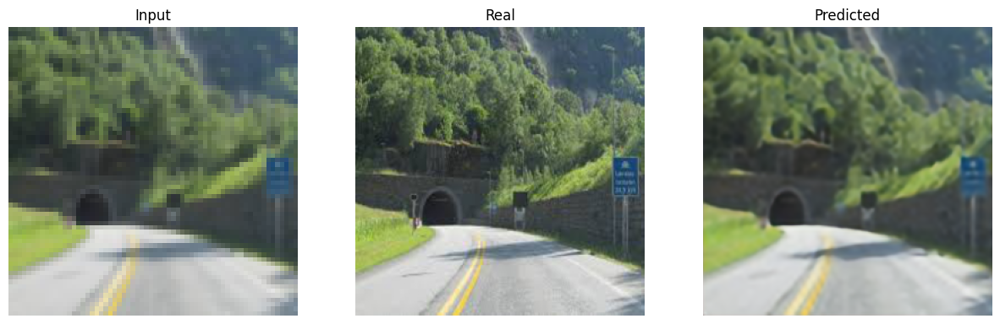

-----------------------------------------------------------
| End of epoch  91 | Time: 50.75s | Train psnr   25.458 | Train Loss    0.066 | Valid psnr   25.422 | Valid Loss    0.064 
-----------------------------------------------------------
| epoch  92 |    50/   86 batches | avg_psnr   25.291 | elapsed time 27.35s
-----------------------------------------------------------
| End of epoch  92 | Time: 50.06s | Train psnr   25.338 | Train Loss    0.067 | Valid psnr   25.302 | Valid Loss    0.066 
-----------------------------------------------------------
| epoch  93 |    50/   86 batches | avg_psnr   25.272 | elapsed time 27.19s
-----------------------------------------------------------
| End of epoch  93 | Time: 49.96s | Train psnr   25.337 | Train Loss    0.068 | Valid psnr   25.303 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  94 |    50/   86 batches | avg_psnr   25.291 | elapsed time 27.29s
-------------------------------------------

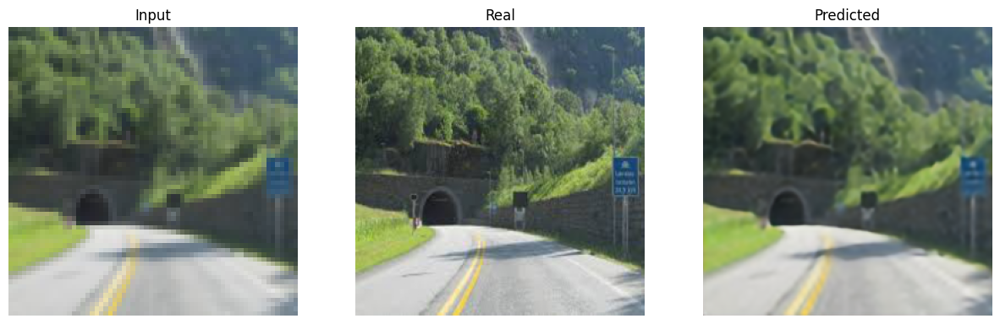

-----------------------------------------------------------
| End of epoch  96 | Time: 51.00s | Train psnr   25.489 | Train Loss    0.065 | Valid psnr   25.464 | Valid Loss    0.063 
-----------------------------------------------------------
| epoch  97 |    50/   86 batches | avg_psnr   25.383 | elapsed time 27.25s
-----------------------------------------------------------
| End of epoch  97 | Time: 50.03s | Train psnr   25.489 | Train Loss    0.065 | Valid psnr   25.102 | Valid Loss    0.072 
-----------------------------------------------------------
| epoch  98 |    50/   86 batches | avg_psnr   25.471 | elapsed time 27.32s
-----------------------------------------------------------
| End of epoch  98 | Time: 49.83s | Train psnr   25.484 | Train Loss    0.065 | Valid psnr   25.270 | Valid Loss    0.067 
-----------------------------------------------------------
| epoch  99 |    50/   86 batches | avg_psnr   25.409 | elapsed time 27.37s
-------------------------------------------

<ipython-input-17-c2ed174a60c2>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(save_model + f'/{model_name}.pt'))


In [25]:
import torch.optim as optim

SR_unet_model = UNet().to(device)

criterion = nn.L1Loss()
optimizer = optim.Adam(SR_unet_model.parameters(), lr=1e-4, betas=[0.5,0.999])

save_model = './UNET'
os.makedirs(save_model, exist_ok = True)

EPOCHS = 100
SR_unet_model, metrics = train(
    SR_unet_model, 'SR_unet_model', save_model, optimizer, criterion, train_loader, test_loader, EPOCHS, device
)

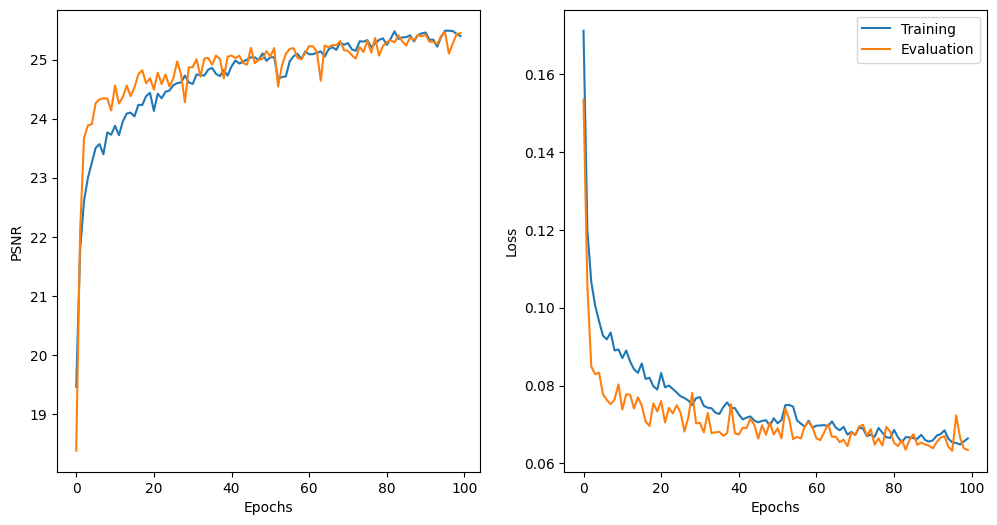

In [26]:
plot_result(
    EPOCHS,
    metrics["train_psnr"],
    metrics["valid_psnr"],
    metrics["train_loss"],
    metrics["valid_loss"]
)

In [27]:
test_psnr, test_loss = evaluate_epoch(SR_unet_model, criterion, test_loader, device)
test_psnr, test_loss

(tensor(25.4645, device='cuda:0'), 0.0632640580562028)

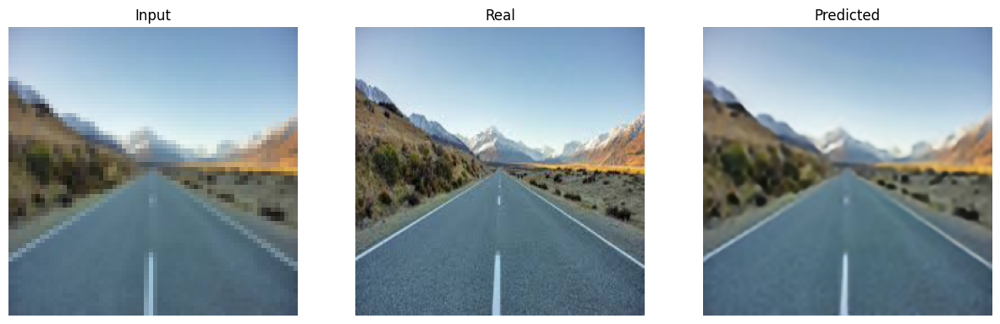

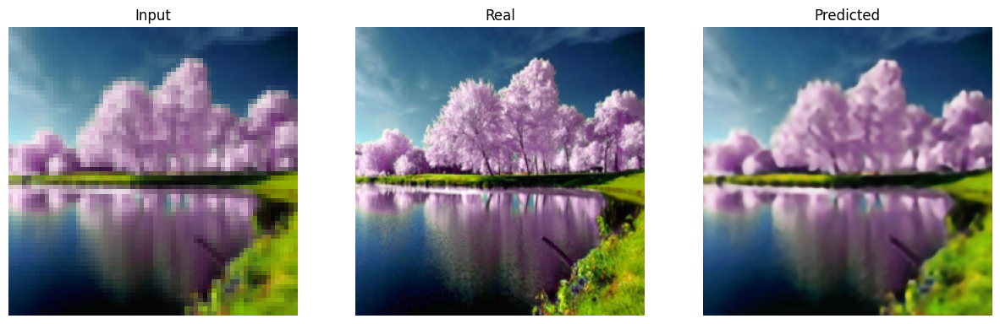

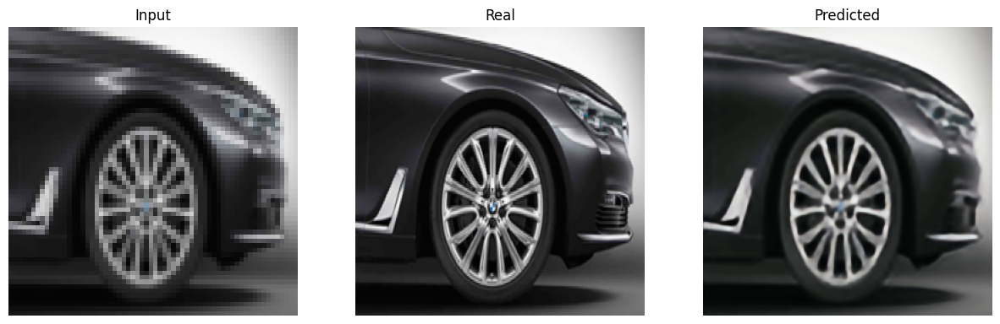

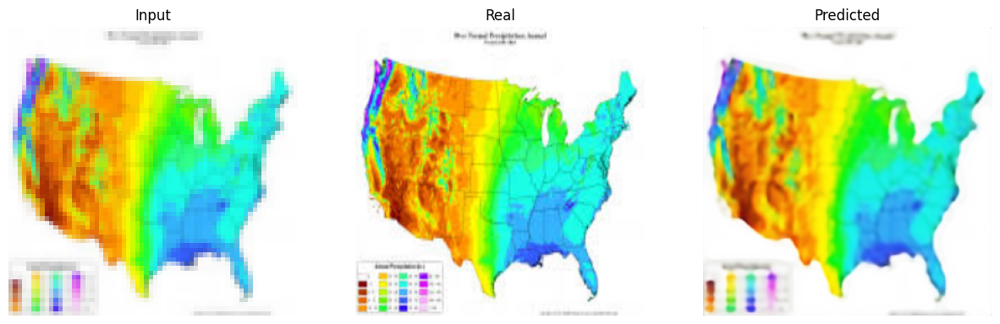

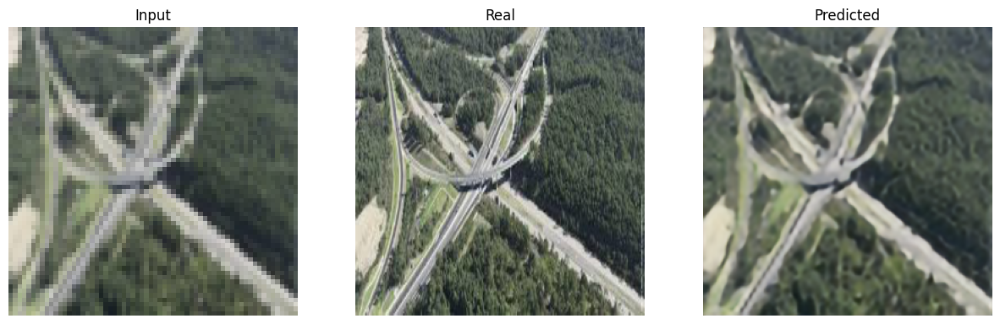

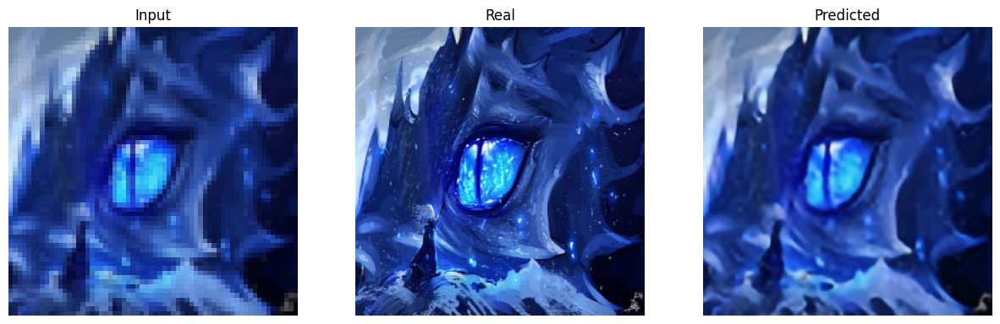

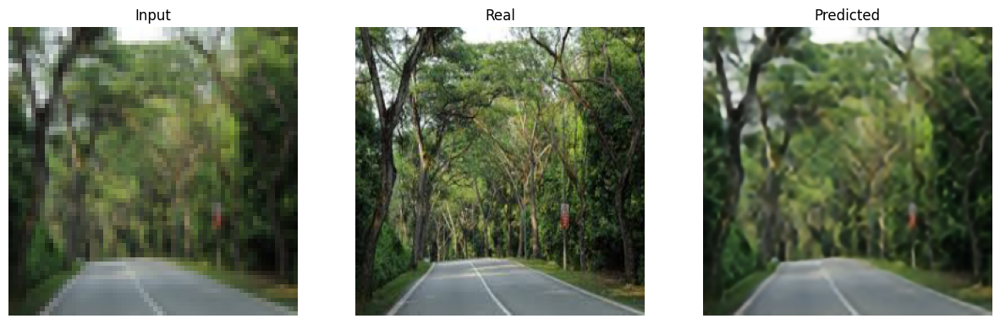

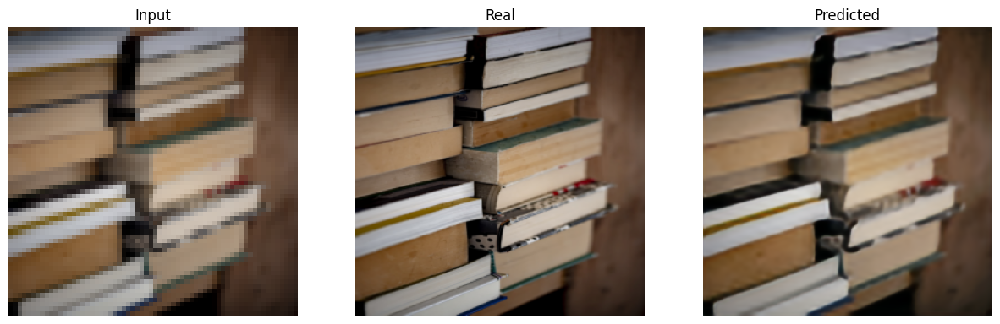

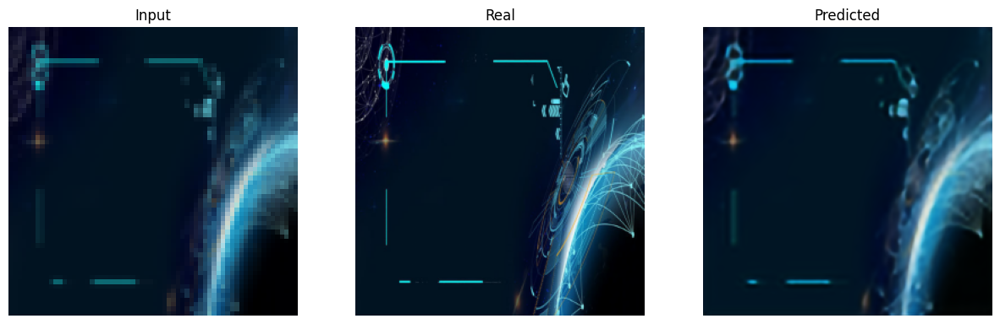

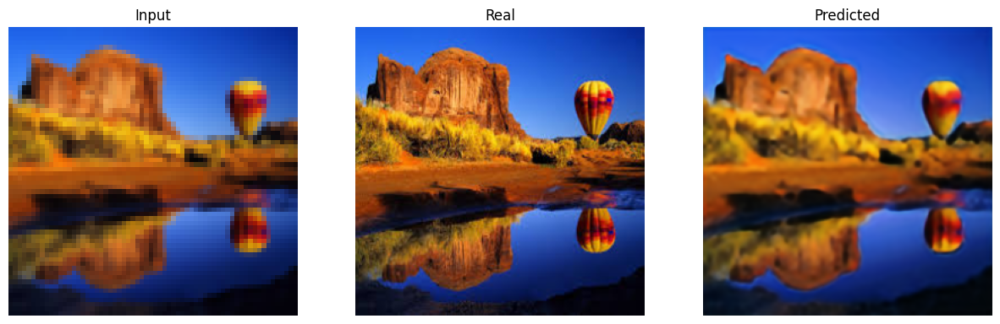

In [28]:
predict_and_display(SR_unet_model, train_loader, device)

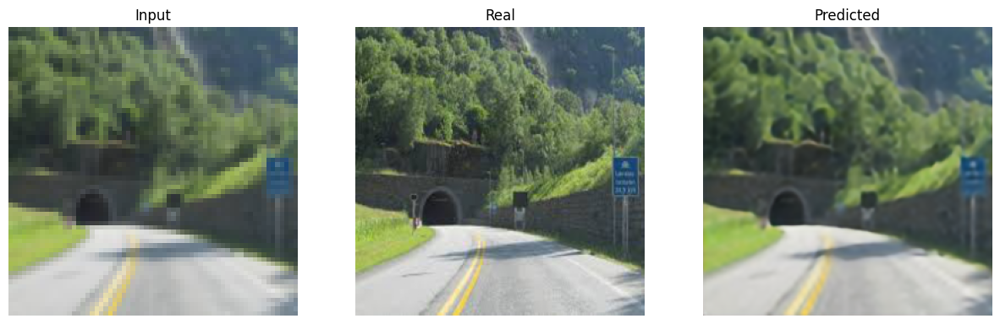

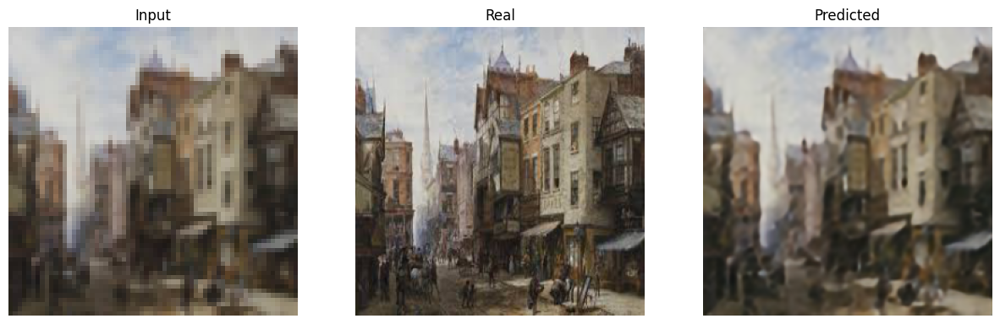

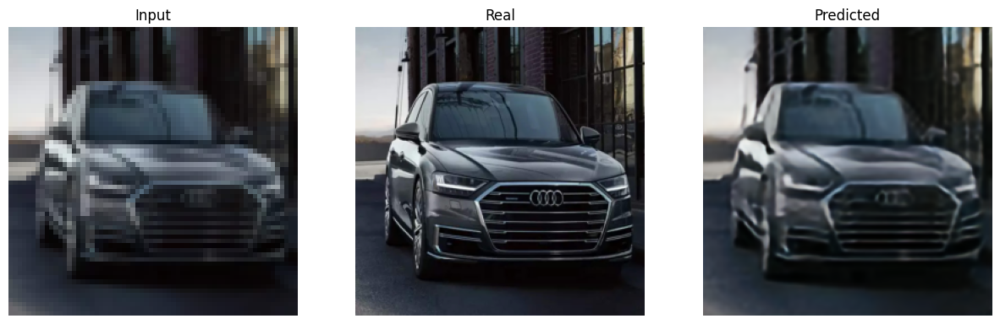

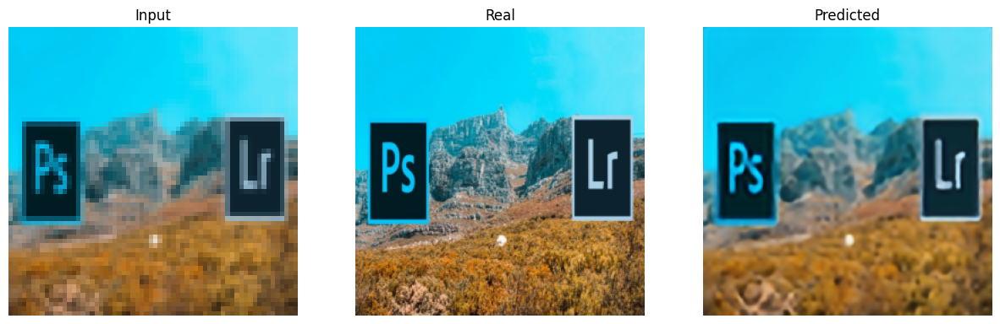

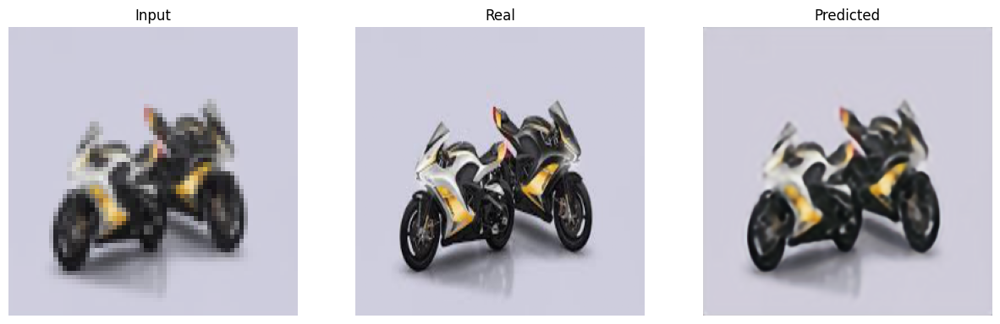

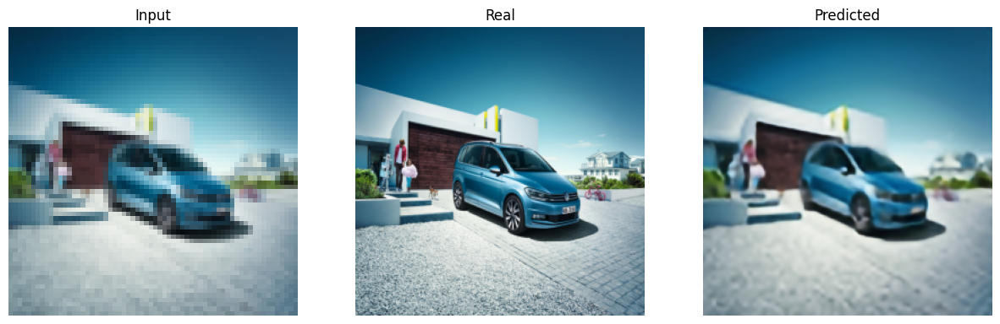

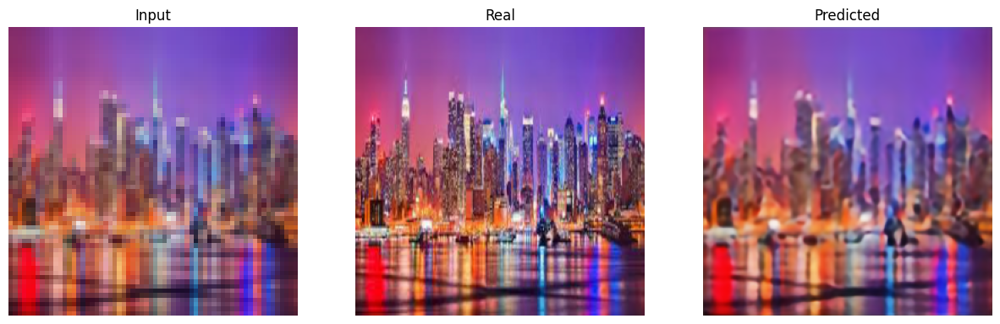

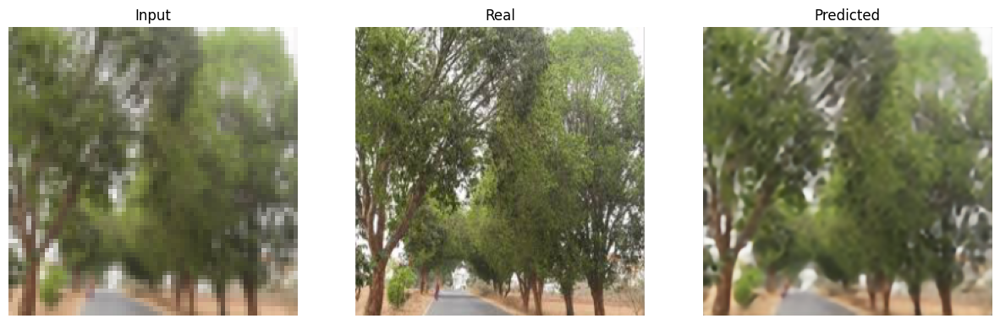

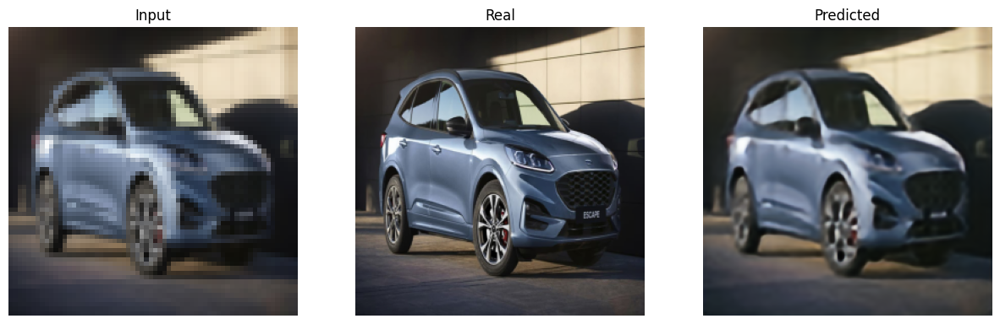

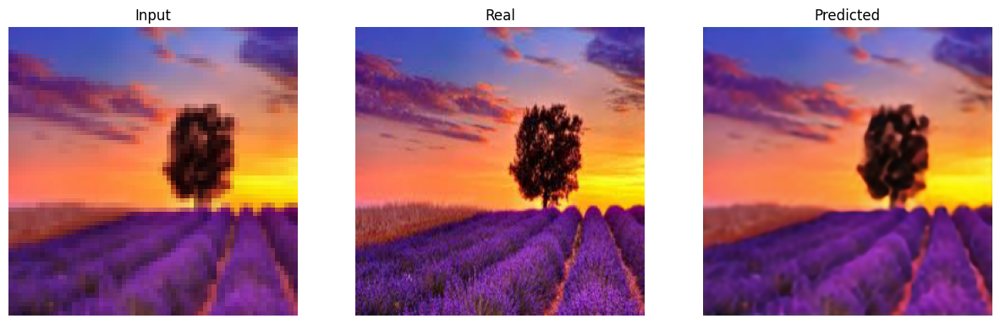

In [29]:
predict_and_display(SR_unet_model, test_loader, device)